<a href="https://colab.research.google.com/github/chase-urasaki/HyTI_Jitter_Metrology/blob/main/Jitter_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

Here is a walk through / refactored notebook of the code that was written for my Master's thesis on the optical metrology system. This notebook is used mainly as a tutorial on how to analyze the data to obtain the data products described. It is meant to be as "plug and play" as possilbe defining functions that will just take in arguements as file names. Please feel free to contact me (chasemu@hawaii.edu) if you have any questions/comments/issues! To actually take data, see the other python codes in the folder. Note that the code is not *perfectly* optimized. There are a lot of things that could still be converted to functions that I just didn't have time to do. Feel free to make changes and submit a pull request!

Change log:


*   4/11/2024 - Created; imported from 3/12 data analysis notebook
*   4/25/2024 - Updated




In [ ]:
#Mount Google drive
from google.colab import drive

drive.mount('/content/drive');

Mounted at /content/drive


In [ ]:
#Navigate to directory
# It will be helpful to store all the data you want to analyze in one place
cd drive/MyDrive/'Jitter Metrology'/'Final_code_and_data'/data

/content/drive/.shortcut-targets-by-id/1oOTCuLadXNs0Gh6zZHhxR42ClxA_yakd/Jitter Metrology/Clean Room Data/3_12_data


In [ ]:
#Import essentials
import numpy as np
import os
from matplotlib import pyplot as plt
from matplotlib import ticker
import scipy.signal as sp
import sys
import pandas as pd
import csv
from scipy.optimize import curve_fit
import scipy.integrate
from numpy.ma.extras import median

In [ ]:
# define some helper functions
def seperate_data_from(data_array):
  """ pulls data from csv file into the x direction, y direction, v sum, and time

      Parameters
      ----------
      data_array: array_like
                  Data array brought in from something like numpy genfromtxt
  """
    xdata = data_array[:,-2]
    ydata = data_array[:,-1]
    vsum_data = data_array[:,-3]
    tdata = data_array[:,1]
    return xdata, ydata, vsum_data, tdata

def one_sided_fft(t,x):
    full_amplitude_spectrum = np.abs(np.fft.fft(x))/x.size
    full_freqs = np.fft.fftfreq(x.size, np.mean(np.ediff1d(t)))
    oneinds = np.where(full_freqs >=0.0)
    one_sided_freqs = full_freqs[oneinds]
    one_sided_amplitude_spectrum=2*full_amplitude_spectrum[oneinds]
    return one_sided_freqs, one_sided_amplitude_spectrum

def power_spectrum(t,x):
    onef, oneamps = one_sided_fft(t,x)
    return onef, oneamps**2

def rad_to_arcsec(radians):
  """ quick function to convert radians to arcsecs"""
  arcsecs = radians * 206264.806
  return arcsecs

def lomb_scargle_pspec(t, x):
    tstep = np.mean(np.ediff1d(t))
    freqs = np.fft.fftfreq(x.size, tstep)
    idxx = np.argsort(freqs)
    one_sided_freqs = freqs[idxx]
    one_sided_freqs = one_sided_freqs[one_sided_freqs>0]
    #KLUDGE TO KEEP PERIODOGRAM FROM CRASHING
    one_sided_freqs = one_sided_freqs+0.00001*np.random.random(one_sided_freqs.size)
    #THE FOLLOWING LINE CRASHES WITHOUT THE KLUDGE
    pgram = sp.lombscargle(t, x, one_sided_freqs*2*np.pi)
    return one_sided_freqs, (pgram/(t.size/4))

def lorentzianoffset(x, x0, A, gamma, y0):
  """ Lorentzian function centered at x0 with the amplitude A and FWHM gamma"""
  return y0 + (A *gamma**2 / (gamma**2 + (x-x0)**2))

In [ ]:
def plot_PSD_and_pos(tdata, xdata, ydata, xpsc, ypsc, plot_title):
  """
  Plots the PSD and time series of the data for visualization purposes

  Parameters
  -----------
  tdata: array_like
        Time data
  xdata: array_like
        x position data
  ydata: array_like
  xpsc: array_like -


  """
  fig_x, (ax1, ax2) = plt.subplots(2,1, figsize =(15,7))
  fig_x.suptitle(str(plot_title)+' (x - dir)')
  fig_x.tight_layout(h_pad = 4.5)
  ax1.plot(xpsc[0], xpsc[1])
  ax1.set_title('PSD')
  ax1.set_xlabel('Frequency [Hz]')
  ax1.set_ylabel(r'Spectral Density [V$^2$/Hz]')
  ax1.tick_params(axis='both', which = 'major', labelsize=11)
  ax1.tick_params(axis='both', which = 'minor', labelsize=11)
  ax2.scatter(tdata, (xdata - np.mean(xdata)) * 1e6, alpha = 0.5)
  ax2.set_title('Position on Sensor',fontsize=18)
  ax2.set_xlabel('Time [s]', fontsize=18)
  ax2.set_ylabel(r'Position [$\mu$m]', fontsize=18)
  ax2.tick_params(axis='both', which = 'major', labelsize=18)
  ax2.tick_params(axis='both', which = 'minor', labelsize=18)

  fig_y, (ax3, ax4) = plt.subplots(2,1, figsize = (15,7))
  fig_y.suptitle(str(plot_title) + ' (y - dir)')
  fig_y.tight_layout(h_pad = 4.5)
  ax3.plot(ypsc[0], ypsc[1], c = 'C1')
  ax3.set_title('FFT')
  ax3.set_xlabel('Frequency [Hz]')
  ax3.set_ylabel(r'Spectral Density [V$^2$/Hz]')
  ax4.scatter(tdata, (ydata - np.mean(ydata)) * 1e6, marker = '.', alpha = 0.5, c = 'C1')
  ax4.set_title('Position on Sensor')
  ax4.set_xlabel('Time [s]')
  ax4.set_ylabel(r'Position [$\mu$m]')

  return fig_x, fig_y

In [ ]:
def plot_PSD_and_pos_angular(tdata, xdisp, ydisp, xpsc_arcsec, ypsc_arcsec, plot_title):
  fig_x, (ax1, ax2) = plt.subplots(2,1, figsize =(15,7))
  fig_x.suptitle(str(plot_title)+' (x - dir)')
  fig_x.tight_layout(h_pad = 4.5)
  ax1.plot(xpsc_arcsec[0], xpsc_arcsec[1])
  ax1.set_title('PSD')
  ax1.set_xlabel('Frequency [Hz]')
  ax1.set_ylabel(r'Spectral Density [arcsec$^2$/Hz]')
  ax1.set_ylim(1e-8,10*max(xpsc_arcsec[1]))
  ax1.set_yscale('log')
  ax1.tick_params(axis='both', which = 'major', labelsize=11)
  ax1.tick_params(axis='both', which = 'minor', labelsize=11)
  ax2.scatter(tdata, xdisp, alpha = 0.5)
  ax2.set_title('Angular Displacement on Sensor')
  ax2.set_xlabel('Time [s]')
  ax2.set_ylabel(r'Displacement [arcsec]')

  fig_y, (ax3, ax4) = plt.subplots(2,1, figsize = (15,7))
  fig_y.suptitle(str(plot_title) + ' (y - dir)')
  fig_y.tight_layout(h_pad = 4.5)
  ax3.plot(ypsc_arcsec[0], ypsc_arcsec[1], c = 'C1')
  ax3.set_title('FFT')
  ax3.set_xlabel('Frequency [Hz]')
  ax3.set_ylabel(r'Spectral Density [arcsec$^2$/Hz]')
  ax3.set_ylim(1e-8,10*max(ypsc_arcsec[1]))
  ax3.set_yscale('log')
  ax4.scatter(tdata, ydisp, marker = '.', alpha = 0.5, c = 'C1')
  ax4.set_title('Angular Displacement on Sensor')
  ax4.set_xlabel('Time [s]')
  ax4.set_ylabel(r'Displacement [arcsec]')

  return fig_x, fig_y

In [ ]:
def zoom_in_on(psc, freq_vals, delta_freq, plot_color):
  """ quick function to zoom in on a certain portion of the power spectrum for analysis

  """
  if len(freq_vals) > 1.5:
    fig, axis = plt.subplots(1,len(freq_vals), sharey = True, figsize = (5*len(freq_vals),5))
    axis = axis.flatten()
    for idx, freq in enumerate(freq_vals):
      axis[idx].plot(psc[0],psc[1], c = str(plot_color))
      axis[idx].set_xlim((freq - delta_freq), (freq + delta_freq))

  else:
    fig, axis = plt.subplots()
    axis.plot(psc[0], psc[1], c = str(plot_color))
    axis.set_xlim((freq_vals[0] - delta_freq), (freq_vals[0] + delta_freq))

  plt.show()
  plt.close()

In [ ]:
def write_array_to_csv(array, filename):
  headers = ['Peak Center [Hz]', 'Peak Amplitude [arcsec^2/Hz]', 'FWHM [Hz]', 'offset', 'Center Variance', 'Peak Variance', 'FWHM Variance', 'Offset Variance', 'Pointing rms [arcsec]', 'Poitning rms - Error [arcsec]']
  with open(filename, 'w', newline = '') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(headers)
    writer.writerows(array)

In [ ]:
def keep_peaks_from(indicies_list, result_array, array_name):
  """ filters out peaks that user wishes to keep and writes them to csv file with the headers
  as described in the write array to csv function """

  final_array = np.zeros((len(indicies_list), 8))

  for i in range(len(indicies_list)):
    final_array[i,:] = result_array[indicies_list[i], :]

  write_array_to_csv(final_array, array_name)


  return final_array

In [ ]:
def do_science_with_offset(freq_range, psd_values, psd_error, plot_it, dir, prom, thresh):
  fit_margin = 6

  peaks_list,_ = scipy.signal.find_peaks(psd_values, prominence = float(prom), threshold = float(thresh), distance = 900) #5 Hz
  peak_amps = np.asarray(psd_values)[peaks_list]
  peak_freqs = np.asarray(freq_range)[peaks_list].flatten()

  # make empty array with size: # of peaks (rows) and 8 variables (columns)
  results_array = np.zeros((len(peaks_list), 8))

  #for each peak, do fit
  for i in range(len(peak_freqs)):
    #print("Finding", peak_freqs[i])
    center_freq = peak_freqs[i]
    amp = peak_amps[i]
    #select appropiate range of data:
    applicable_range = freq_range[(freq_range[0] >= (center_freq - fit_margin)) & (freq_range[0] <=(center_freq + fit_margin))].index.values

    freqs_lower_idx, freqs_upper_idx = applicable_range[0], applicable_range[-1]

    freqs = np.asarray(freq_range.loc[freqs_lower_idx:freqs_upper_idx]).flatten()
    #print(freqs)
    values_to_fit = np.asarray(psd_values.loc[freqs_lower_idx:freqs_upper_idx])
    y_offset = median(values_to_fit)
    #print(values_to_fit)
    valueerrs_to_fit = np.asarray(psd_error.loc[freqs_lower_idx:freqs_upper_idx])

    p0 = center_freq, amp, 0.1, y_offset
    #print(p0)


    max_its = 500
    converged = False

    for iteration in range(max_its):
      try:
        popt, pcov  = curve_fit(lorentzianoffset, freqs, values_to_fit, p0)
        yfit = lorentzianoffset(freqs, *popt)

        if np.all(popt != np.inf):
          converged = True
          break
      except RuntimeError:
        pass
    if converged:
      #center, amp, fwhm, variance center, variance amp, variance fwhm
      results_array[i] = *popt, *np.diag(pcov)

    else:
      continue

  def filter_array(result_array):
  #Remove any points that are all 0's - this means the fit didn't converge
    cleaned_array = result_array[result_array[:,0] > 0]

    #remove any points that are greater than 500 Hz
    cleaned_array = cleaned_array[cleaned_array[:,0]< 500]
    cleaned_array = cleaned_array[cleaned_array[:,1]> 0]

    return(cleaned_array)

  results_array = filter_array(results_array)

  if plot_it == True:

    if dir == 'x':
      point_fmt = 'C0.'
    elif dir == 'y':
      point_fmt = 'C1.'

  fig, ax = plt.subplots(figsize = (12,5))
  ax.errorbar(freq_range, psd_values, yerr= psd_error, fmt = point_fmt, ecolor = 'red', elinewidth = 0.75, zorder = 0)
  ax.set_ylim(1e-12,5*max(psd_values))
  ax.set_yscale('log', nonpositive = 'clip')
  ax.scatter(results_array[:,0], results_array[:,1], marker = 'x', color = 'k', zorder = 1)
  for index in range(len(results_array[:,0])):
    ax.text(results_array[index,0], results_array[index,1], str(index), fontsize = 8, color = 'k')
  ax.set_title('Found peaks in {}- direction'.format(dir))
  ax.set_xlabel('Frequency [Hz]')
  ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

  return results_array


In [ ]:

def do_science(freq_range, psd_values, psd_error, plot_it):
  """ This one has already uses the lorentzian with an offset"""

  fit_margin = 6
  #Find the peaks
  peaks_list,_ = scipy.signal.find_peaks(psd_values, prominence = 1e-6, threshold = 1e-6, distance = 900) #5 Hz
  peak_amps = np.asarray(psd_values)[peaks_list]
  peak_freqs = np.asarray(freq_range)[peaks_list].flatten()

  #print(peak_amps)
  #print(peak_freqs)

  # make empty array with size: # of peaks (rows) and 8 variables (columns)
  results_array = np.zeros((len(peaks_list), 8))

  #for each peak, do fit
  for i in range(len(peak_freqs)):
    #print("Finding", peak_freqs[i])
    center_freq = peak_freqs[i]
    amp = peak_amps[i]
    #select appropiate range of data:
    applicable_range = freq_range[(freq_range[0] >= (center_freq - fit_margin)) & (freq_range[0] <=(center_freq + fit_margin))].index.values

    freqs_lower_idx, freqs_upper_idx = applicable_range[0], applicable_range[-1]

    freqs = np.asarray(bearingoff_electronicson_freqs.loc[freqs_lower_idx:freqs_upper_idx]).flatten()
    #print(freqs)
    values_to_fit = np.asarray(psd_values.loc[freqs_lower_idx:freqs_upper_idx])
    y_offset = median(values_to_fit)
    #print(values_to_fit)
    valueerrs_to_fit = np.asarray(psd_error.loc[freqs_lower_idx:freqs_upper_idx])

    p0 = center_freq, amp, 0.2, y_offset
    #print(p0)


    max_its = 500
    converged = False

    for iteration in range(max_its):
      try:
        popt, pcov  = curve_fit(lorentzianoffset, freqs, values_to_fit, p0)
        yfit = lorentzianoffset(freqs, *popt)

        if np.all(popt != np.inf):
          converged = True
          break
      except RuntimeError:
        pass
    if converged:
      #print('fit!')
      #center, amp, fwhm, variance center, variance amp, variance fwhm
      results_array[i] = *popt, *np.diag(pcov)

    else:
      continue
  # #append center, center variance, amp, amp variance, fwhm, fwhm variance to array
  #     results_array[i] = *popt, *np.diagonal(pcov)

  # #     if plot_it == True:
  #       fig, ax = plt.subplots(figsize = (15,5))
  #       ax.errorbar(freqs, values_to_fit, yerr=valueerrs_to_fit, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75)
  #       #ax.set_ylim(0,1e-4)
  #       ax.set_xlim(freqs[0], freqs[-1])
  #       ax.scatter(peak_freqs[i], peak_amps[i], marker = 'x')
  #       plt.plot(x, yfit, 'k--')
  #       ax.set_title('Peak at '+str(peak_freqs[i]))
  #       ax.set_xlabel('Frequency [Hz]')
  #       ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

  #   #if fit gives runtime error (i.e. did not converge): append 0's and move on to next peak candidate
  #   except RuntimeError:
  #     results_array[i] = 0,0,0,0,0,0
  #     pass

  # #write array out to csv
  #print(results_array)

  #if plot_it == True:
  def filter_array(result_array):
  #Remove any points that are all 0's - this means the fit didn't converge
    cleaned_array = result_array[result_array[:,0] > 0]

    #remove any points that are greater than 500 Hz
    cleaned_array = cleaned_array[cleaned_array[:,0]< 500]
    cleaned_array = cleaned_array[cleaned_array[:,1]> 0]

    return(cleaned_array)

  results_array = filter_array(results_array)

  return results_array


In [ ]:
def lorentzian(x,x0, A, gamma):
  """ Lrentzian function centered at x0 with amplitude A and FWHM gamma"""
  return (A*gamma**2 / (gamma**2 + (x - x0)**2))

The throw distance in this case is the distance from the laser to the front size housing of sensor. From my measurements, this was 109.83 mm and from the CAD, we must add an additional 3.05 mm as the distance from the front side housing to the sensor. This comes out to 112.88 mm of total distance between the laser and the sensor. By dividing this distance out by the positional displacement and then convert into arcsec and then take t4he FT of the results.

# Configuration 1

This configuration is for the air bearing off, payload and cryocooler off, and ADCS off. The data here is representative of the ambient vibrations going on in the cleanroom due to *mostly seismic* activity.

In [ ]:
bearingoff_electronicsoff_1 = np.genfromtxt('data_3_13_bearingoff_electronicsoff_1in_20230313-162724.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicsoff_1_xdata, bearingoff_electronicsoff_1_ydata, bearingoff_electronicsoff_1_vsum, bearingoff_electronicsoff_1_tdata = seperate_data_from(bearingoff_electronicsoff_1)
bearingoff_electronicsoff_1_xdisp = rad_to_arcsec(((bearingoff_electronicsoff_1_xdata) - np.mean(bearingoff_electronicsoff_1_xdata)) / throw_distance)
bearingoff_electronicsoff_1_ydisp = rad_to_arcsec(((bearingoff_electronicsoff_1_ydata) - np.mean(bearingoff_electronicsoff_1_ydata)) / throw_distance)
bearingoff_electronicsoff_1_xpsc_arcsec = power_spectrum(bearingoff_electronicsoff_1_tdata, bearingoff_electronicsoff_1_xdisp)
bearingoff_electronicsoff_1_ypsc_arcsec = power_spectrum(bearingoff_electronicsoff_1_tdata, bearingoff_electronicsoff_1_ydisp)

In [ ]:
bearingoff_electronicsoff_3 = np.genfromtxt('data_3_13_bearingoff_electronicsoff_3in_20230313-163728.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicsoff_3_xdata, bearingoff_electronicsoff_3_ydata, bearingoff_electronicsoff_3_vsum, bearingoff_electronicsoff_3_tdata = seperate_data_from(bearingoff_electronicsoff_3)
bearingoff_electronicsoff_3_xdisp = rad_to_arcsec(((bearingoff_electronicsoff_3_xdata) - np.mean(bearingoff_electronicsoff_3_xdata)) / throw_distance)
bearingoff_electronicsoff_3_ydisp = rad_to_arcsec(((bearingoff_electronicsoff_3_ydata) - np.mean(bearingoff_electronicsoff_3_ydata)) / throw_distance)
bearingoff_electronicsoff_3_xpsc_arcsec = power_spectrum(bearingoff_electronicsoff_3_tdata, bearingoff_electronicsoff_3_xdisp)
bearingoff_electronicsoff_3_ypsc_arcsec = power_spectrum(bearingoff_electronicsoff_3_tdata, bearingoff_electronicsoff_3_ydisp)

In [ ]:
bearingoff_electronicsoff_4 = np.genfromtxt('data_3_13_bearingoff_electronicsoff_4in_20230313-164202.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicsoff_4_xdata, bearingoff_electronicsoff_4_ydata, bearingoff_electronicsoff_4_vsum, bearingoff_electronicsoff_4_tdata = seperate_data_from(bearingoff_electronicsoff_4)
bearingoff_electronicsoff_4_xdisp = rad_to_arcsec(((bearingoff_electronicsoff_4_xdata) - np.mean(bearingoff_electronicsoff_4_xdata)) / throw_distance)
bearingoff_electronicsoff_4_ydisp = rad_to_arcsec(((bearingoff_electronicsoff_4_ydata) - np.mean(bearingoff_electronicsoff_4_ydata)) / throw_distance)
bearingoff_electronicsoff_4_xpsc_arcsec = power_spectrum(bearingoff_electronicsoff_4_tdata, bearingoff_electronicsoff_4_xdisp)
bearingoff_electronicsoff_4_ypsc_arcsec = power_spectrum(bearingoff_electronicsoff_4_tdata, bearingoff_electronicsoff_4_ydisp)

In [ ]:
bearingoff_electronicsoff_5 = np.genfromtxt('data_3_13_bearingoff_electronicsoff_5in_20230313-164831.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicsoff_5_xdata, bearingoff_electronicsoff_5_ydata, bearingoff_electronicsoff_5_vsum, bearingoff_electronicsoff_5_tdata = seperate_data_from(bearingoff_electronicsoff_5)
bearingoff_electronicsoff_5_xdisp = rad_to_arcsec(((bearingoff_electronicsoff_5_xdata) - np.mean(bearingoff_electronicsoff_5_xdata)) / throw_distance)
bearingoff_electronicsoff_5_ydisp = rad_to_arcsec(((bearingoff_electronicsoff_5_ydata) - np.mean(bearingoff_electronicsoff_5_ydata)) / throw_distance)
bearingoff_electronicsoff_5_xpsc_arcsec = power_spectrum(bearingoff_electronicsoff_5_tdata, bearingoff_electronicsoff_5_xdisp)
bearingoff_electronicsoff_5_ypsc_arcsec = power_spectrum(bearingoff_electronicsoff_5_tdata, bearingoff_electronicsoff_5_ydisp)

In [ ]:
bearingoff_electronicsoff_6 = np.genfromtxt('data_3_13_bearingoff_electronicsoff_6in_20230313-164831.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicsoff_6_xdata, bearingoff_electronicsoff_6_ydata, bearingoff_electronicsoff_6_vsum, bearingoff_electronicsoff_6_tdata = seperate_data_from(bearingoff_electronicsoff_6)
bearingoff_electronicsoff_6_xdisp = rad_to_arcsec(((bearingoff_electronicsoff_6_xdata) - np.mean(bearingoff_electronicsoff_6_xdata)) / throw_distance)
bearingoff_electronicsoff_6_ydisp = rad_to_arcsec(((bearingoff_electronicsoff_6_ydata) - np.mean(bearingoff_electronicsoff_6_ydata)) / throw_distance)
bearingoff_electronicsoff_6_xpsc_arcsec = power_spectrum(bearingoff_electronicsoff_6_tdata, bearingoff_electronicsoff_6_xdisp)
bearingoff_electronicsoff_6_ypsc_arcsec = power_spectrum(bearingoff_electronicsoff_6_tdata, bearingoff_electronicsoff_6_ydisp)

In [ ]:
# Average out all the psd plots
bearingoff_electronicsoff_psds_x = pd.DataFrame([bearingoff_electronicsoff_1_xpsc_arcsec[1], bearingoff_electronicsoff_3_xpsc_arcsec[1], bearingoff_electronicsoff_4_xpsc_arcsec[1],
                                                      bearingoff_electronicsoff_5_xpsc_arcsec[1], bearingoff_electronicsoff_6_xpsc_arcsec[1]])
bearingoff_electronicsoff_psds_y = pd.DataFrame([bearingoff_electronicsoff_1_ypsc_arcsec[1], bearingoff_electronicsoff_3_ypsc_arcsec[1], bearingoff_electronicsoff_4_ypsc_arcsec[1],
                                                      bearingoff_electronicsoff_5_ypsc_arcsec[1], bearingoff_electronicsoff_6_ypsc_arcsec[1]])

# Get the frequency divisions from any one of the psd plots a robust test would check all combinations, but I'm going to assume pcking two randomly shall suffice.
if np.array_equiv(bearingoff_electronicsoff_1_xpsc_arcsec[0], bearingoff_electronicsoff_5_ypsc_arcsec[0]):
  bearingoff_electronicsoff_freqs = bearingoff_electronicsoff_1_xpsc_arcsec[0]
else:
  raise Exception("Frequency binning does not match")

In [ ]:
bearingoff_electronicsoff_x_avgs = bearingoff_electronicsoff_psds_x.mean(axis = 0)
bearingoff_electronicsoff_x_SEM = bearingoff_electronicsoff_psds_x.sem(axis = 0)
bearingoff_electronicsoff_y_avgs = bearingoff_electronicsoff_psds_y.mean(axis = 0)
bearingoff_electronicsoff_y_SEM = bearingoff_electronicsoff_psds_y.sem(axis =  0)

In [ ]:
bearingoff_electronicsoff_x_avgs_df = data_as_df(bearingoff_electronicsoff_x_avgs)
bearingoff_electronicsoff_y_avgs_df = data_as_df(bearingoff_electronicsoff_y_avgs)
bearingoff_electronicsoff_x_SEM_df = data_as_df(bearingoff_electronicsoff_x_SEM)
bearingoff_electronicsoff_y_SEM_df = data_as_df (bearingoff_electronicsoff_y_SEM)
bearingoff_electronicsoff_freqs_df = data_as_df(bearingoff_electronicsoff_freqs)

In [ ]:
# Find the jitter values by integrating the PSD from the index of your frequency of interest to the end
bearingoff_electronicsoff_x_var = (scipy.integrate.trapezoid(np.asarray(bearingoff_electronicsoff_x_avgs_df.iloc[25020:]).flatten(),
                                                                np.asarray(bearingoff_electronicsoff_freqs.iloc[25020:]).flatten()))
bearingoff_electronicsoff_y_var = (scipy.integrate.trapezoid(np.asarray(bearingoff_electronicsoff_y_avgs_df.iloc[25020:]).flatten(),
                                                                np.asarray(bearingoff_electronicsoff_freqs.iloc[25020:]).flatten()))
bearingoff_electronicsoff_x_var, bearingoff_electronicsoff_y_var

In [ ]:
# Assuming the variance values are independent, Future work devoted to factually trying to compute the covariance values.
bearingoff_electronicson_var = bearingoff_electronicsoff_x_var + bearingoff_electronicsoff_y_var
np.sqrt(bearingoff_electronicson_var), 2*np.sqrt(bearingoff_electronicson_var), 3*np.sqrt(bearingoff_electronicson_var)

In [ ]:
bearingoff_electronicsoff_x_peaks = do_science_with_offset(bearingoff_electronicsoff_freqs_df, bearingoff_electronicsoff_x_avgs, bearingoff_electronicsoff_x_SEM, True, 'x',1e-6, 1e-7)

In [ ]:
x_peaks = [18,19] #indicies 18 and 19 were found by manual inspection
bearingoff_electronicsoff_real_xpeaks = keep_peaks_and_int_from(x_peaks, bearingoff_electronicsoff_x_peaks, 'Bearingoff_electronicsoff_x.csv')
plot_peaks(bearingoff_electronicsoff_real_xpeaks, bearingoff_electronicsoff_freqs, bearingoff_electronicsoff_x_avgs,
           bearingoff_electronicsoff_x_SEM, ' ', 'x')

In [ ]:
bearingoff_electronicsoff_y_peaks = do_science_with_offset(bearingoff_electronicsoff_freqs_df, bearingoff_electronicsoff_y_avgs, bearingoff_electronicsoff_y_SEM, True, 'y',1e-7,0.5*1e-7)

In [ ]:
y_peaks = [2, 4, 6,7,8, 10,15,19, 22, 26, 31]
bearingoff_electronicsoff_real_ypeaks = keep_peaks_and_int_from(y_peaks, bearingoff_electronicsoff_y_peaks, 'Bearingoff_electronicsoff_y.csv')
plot_peaks(bearingoff_electronicsoff_real_ypeaks, bearingoff_electronicsoff_freqs, bearingoff_electronicsoff_y_avgs,
           bearingoff_electronicsoff_y_SEM, ' ', 'y')

# Bearing off, Payload and Cryocooler on, ADCS off

The measured distances: 99.4 cm from the front edge of the jig to the detector and 100.0 cm from the front eduge of the jig to the front of the lens tube. Distance from to the front edge is 232.59 mm. From the CAD model, the lenght of the lens tube from the front of edge to the sensor housing is 51.6 mm and the distance from the front side hou sing to the actual sensor is 3.05 mm. This comes out to a total throw distance of 2.514 m.

In [ ]:
bearingoff_electronicson_6 = np.genfromtxt('data_3_12_bearingoff_electronicson_6in_20230312-140845.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_6_xdata, bearingoff_electronicson_6_ydata, bearingoff_electronicson_6_vsum, bearingoff_electronicson_6_tdata = seperate_data_from(bearingoff_electronicson_6)
bearingoff_electronicson_6_xpsc = power_spectrum(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_xdata - np.mean(bearingoff_electronicson_6_xdata)))
bearingoff_electronicson_6_ypsc = power_spectrum(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_ydata - np.mean(bearingoff_electronicson_6_ydata)))
# bearingoff_electronicson_6_plot = plot_FFT_and_pos(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_xdata, bearingoff_electronicson_6_ydata, bearingoff_electronicson_6_xpsc, bearingoff_electronicson_6_ypsc, 'Bearing Off, Payload & Cryocooler on - Trial 6')

Let's convert the above results into an angular displacement and then see what we kind of displacements we can measure.

In [ ]:
bearingoff_electronicson_throw_distance = 2.514 - 99.4e-2 - 232.59e-3
bearingoff_electronicson_throw_distance

1.2874099999999997

In [ ]:
bearingoff_electronicson_6_xdisp = rad_to_arcsec((bearingoff_electronicson_6_xdata - np.mean(bearingoff_electronicson_6_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_6_ydisp = rad_to_arcsec((bearingoff_electronicson_6_ydata - np.mean(bearingoff_electronicson_6_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_6_xpsc_arcsec = power_spectrum(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_xdisp)
bearingoff_electronicson_6_ypsc_arcsec = power_spectrum(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_ydisp)

# plot_FFT_and_pos_angular(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_xdisp, bearingoff_electronicson_6_ydisp,
                        #  bearingoff_electronicson_6_xpsc_arcsec, bearingoff_electronicson_6_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 6')

(<Figure size 1500x700 with 2 Axes>, <Figure size 1500x700 with 2 Axes>)

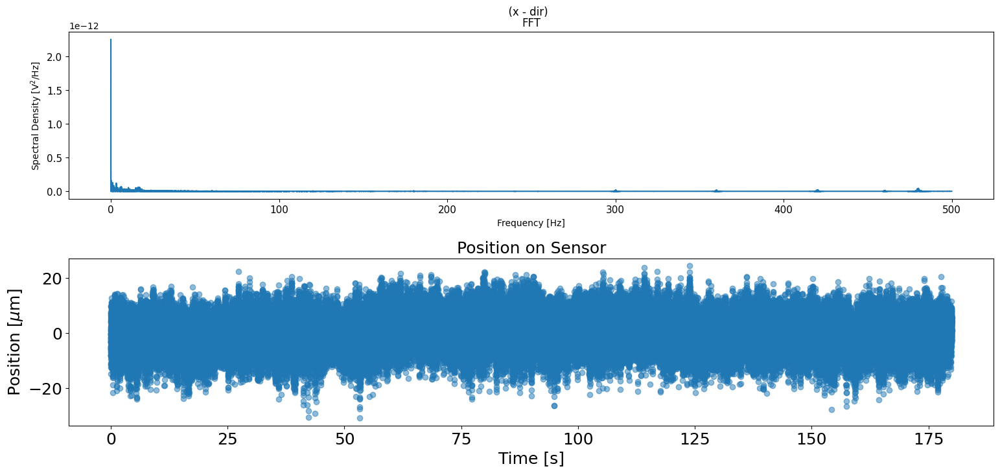

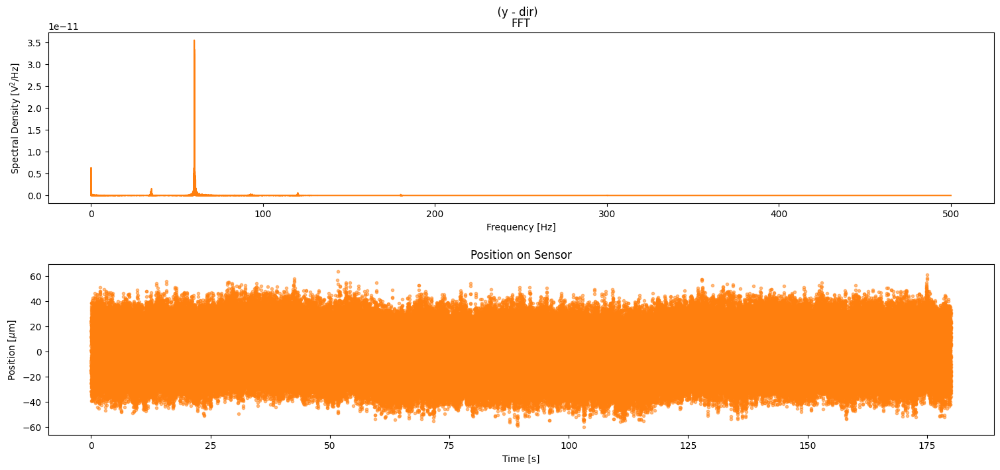

In [ ]:
#make plots for thesis
plot_FFT_and_pos(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_xdata,
                 bearingoff_electronicson_6_ydata, bearingoff_electronicson_6_xpsc,
                 bearingoff_electronicson_6_ypsc, " ")

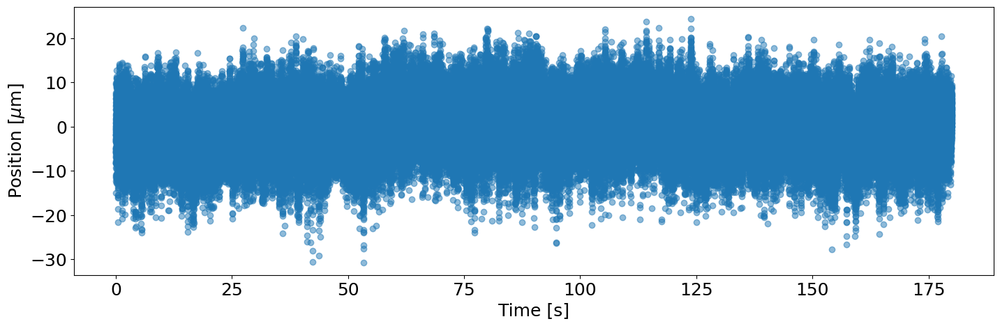

In [ ]:
#make plot for thesis
position_example_fig, ax = plt.subplots(figsize = (17,5))
ax.scatter(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_xdata - np.mean(bearingoff_electronicson_6_xdata)) * 1e6, alpha = 0.5)
#ax.set_title('Position on Sensor',fontsize=18)
ax.set_xlabel('Time [s]', fontsize=18)
ax.set_ylabel(r'Position [$\mu$m]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

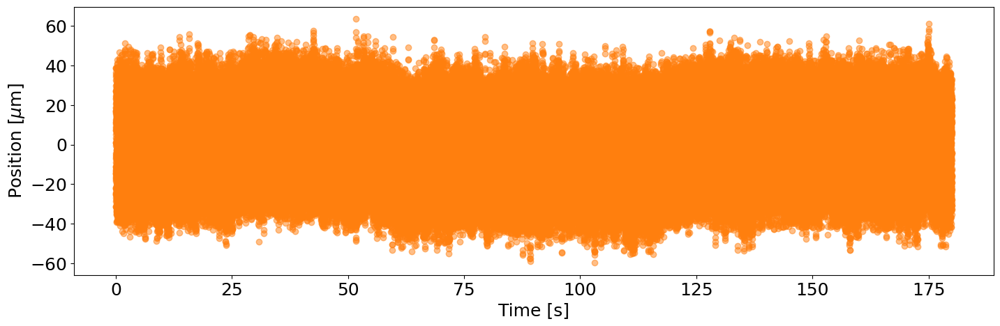

In [ ]:
position_example_fig_y, ax = plt.subplots(figsize = (17,5))
ax.scatter(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_ydata - np.mean(bearingoff_electronicson_6_ydata)) * 1e6, c = 'C1', alpha = 0.5)
#ax.set_title('Position on Sensor',fontsize=18)
ax.set_xlabel('Time [s]', fontsize=18)
ax.set_ylabel(r'Position [$\mu$m]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

(<Figure size 1500x700 with 2 Axes>, <Figure size 1500x700 with 2 Axes>)

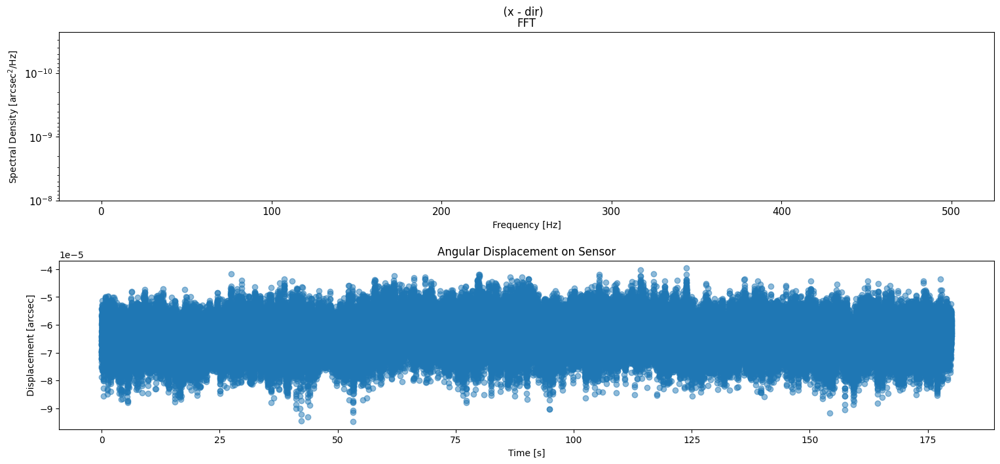

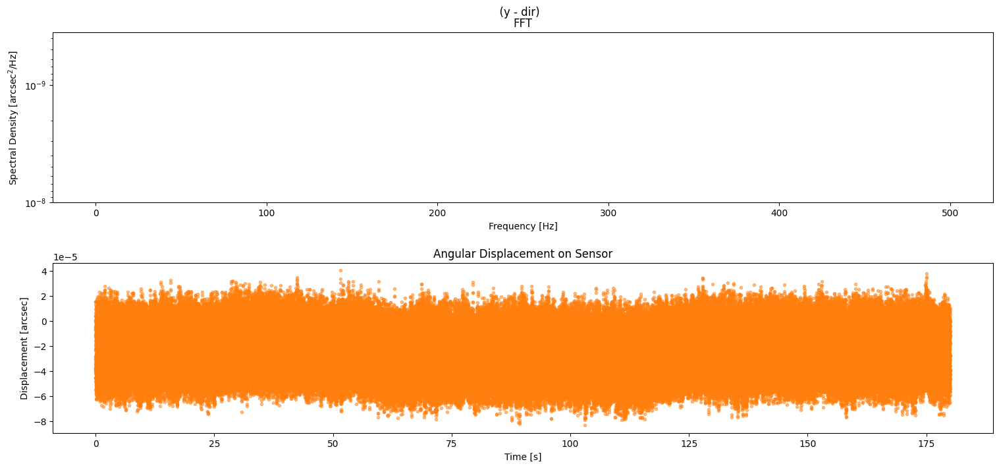

In [ ]:
plot_FFT_and_pos_angular(bearingoff_electronicson_6_tdata, bearingoff_electronicson_6_xdata,
                 bearingoff_electronicson_6_ydata, bearingoff_electronicson_6_xpsc,
                 bearingoff_electronicson_6_ypsc, " ")

In [ ]:
bearingoff_electronicson_7 = np.genfromtxt('data_3_12_bearingoff_electronicson_7in_20230312-141327.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_7_xdata, bearingoff_electronicson_7_ydata, bearingoff_electronicson_7_vsum, bearingoff_electronicson_7_tdata = seperate_data_from(bearingoff_electronicson_7)
bearingoff_electronicson_7_xpsc = power_spectrum(bearingoff_electronicson_7_tdata, (bearingoff_electronicson_7_xdata - np.mean(bearingoff_electronicson_7_xdata)))
bearingoff_electronicson_7_ypsc = power_spectrum(bearingoff_electronicson_7_tdata, (bearingoff_electronicson_7_ydata - np.mean(bearingoff_electronicson_7_ydata)))
# bearingoff_electronicson_7_plot = plot_FFT_and_pos(bearingoff_electronicson_7_tdata, bearingoff_electronicson_7_xdata, bearingoff_electronicson_7_ydata, bearingoff_electronicson_7_xpsc, bearingoff_electronicson_7_ypsc, 'Bearing Off, Payload & Cryocooler on - Trial 7')

In [ ]:
bearingoff_electronicson_7_xdisp = rad_to_arcsec((bearingoff_electronicson_7_xdata - np.mean(bearingoff_electronicson_7_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_7_ydisp = rad_to_arcsec((bearingoff_electronicson_7_ydata - np.mean(bearingoff_electronicson_7_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_7_xpsc_arcsec = power_spectrum(bearingoff_electronicson_7_tdata, bearingoff_electronicson_7_xdisp)
bearingoff_electronicson_7_ypsc_arcsec = power_spectrum(bearingoff_electronicson_7_tdata, bearingoff_electronicson_7_ydisp)

# plot_FFT_and_pos_angular(bearingoff_electronicson_7_tdata, bearingoff_electronicson_7_xdisp, bearingoff_electronicson_7_ydisp,
                        #  bearingoff_electronicson_7_xpsc_arcsec, bearingoff_electronicson_7_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 7')

In [ ]:
bearingoff_electronicson_8 = np.genfromtxt('data_3_12_bearingoff_electronicson_8in_20230312-142003.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_8_xdata, bearingoff_electronicson_8_ydata, bearingoff_electronicson_8_vsum, bearingoff_electronicson_8_tdata = seperate_data_from(bearingoff_electronicson_8)
bearingoff_electronicson_8_xpsc = power_spectrum(bearingoff_electronicson_8_tdata, (bearingoff_electronicson_8_xdata - np.mean(bearingoff_electronicson_8_xdata)))
bearingoff_electronicson_8_ypsc = power_spectrum(bearingoff_electronicson_8_tdata, (bearingoff_electronicson_8_ydata - np.mean(bearingoff_electronicson_8_ydata)))
# bearingoff_electronicson_8_plot = plot_FFT_and_pos(bearingoff_electronicson_8_tdata, bearingoff_electronicson_8_xdata, bearingoff_electronicson_8_ydata, bearingoff_electronicson_8_xpsc, bearingoff_electronicson_8_ypsc, 'Bearing Off, Payload & Cryocooler on - Trial 8')

In [ ]:
bearingoff_electronicson_8_xdisp = rad_to_arcsec((bearingoff_electronicson_8_xdata - np.mean(bearingoff_electronicson_8_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_8_ydisp = rad_to_arcsec((bearingoff_electronicson_8_ydata - np.mean(bearingoff_electronicson_8_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_8_xpsc_arcsec = power_spectrum(bearingoff_electronicson_8_tdata, bearingoff_electronicson_8_xdisp)
bearingoff_electronicson_8_ypsc_arcsec = power_spectrum(bearingoff_electronicson_8_tdata, bearingoff_electronicson_8_ydisp)

# plot_FFT_and_pos_angular(bearingoff_electronicson_8_tdata, bearingoff_electronicson_8_xdisp, bearingoff_electronicson_8_ydisp,
#                          bearingoff_electronicson_8_xpsc_arcsec, bearingoff_electronicson_8_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 8')

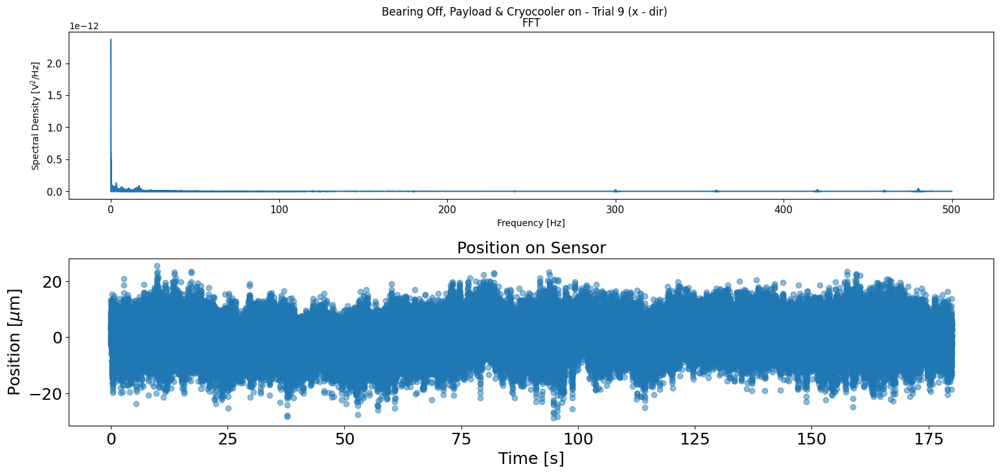

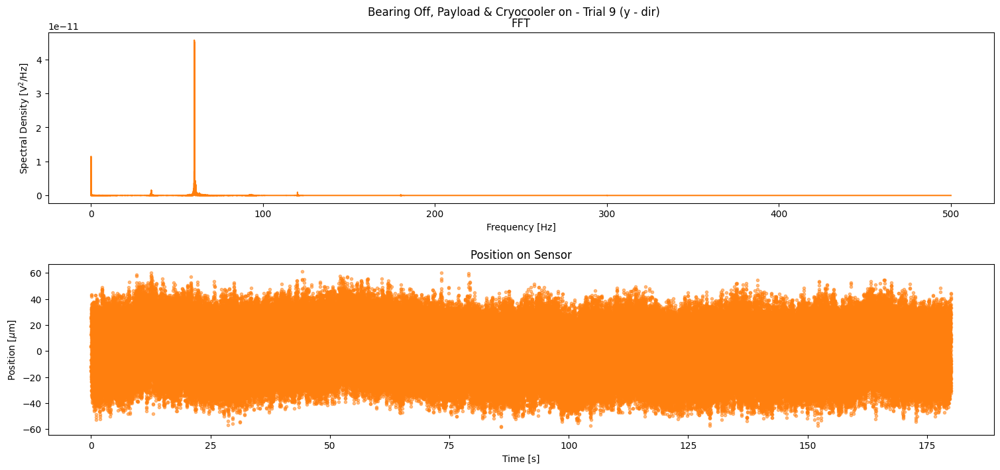

In [ ]:
bearingoff_electronicson_9 = np.genfromtxt('data_3_12_bearingoff_electronicson_9in_20230312-142531.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_9_xdata, bearingoff_electronicson_9_ydata, bearingoff_electronicson_9_vsum, bearingoff_electronicson_9_tdata = seperate_data_from(bearingoff_electronicson_9)
bearingoff_electronicson_9_xpsc = power_spectrum(bearingoff_electronicson_9_tdata, (bearingoff_electronicson_9_xdata - np.mean(bearingoff_electronicson_9_xdata)))
bearingoff_electronicson_9_ypsc = power_spectrum(bearingoff_electronicson_9_tdata, (bearingoff_electronicson_9_ydata - np.mean(bearingoff_electronicson_9_ydata)))
bearingoff_electronicson_9_plot = plot_FFT_and_pos(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_xdata, bearingoff_electronicson_9_ydata, bearingoff_electronicson_9_xpsc, bearingoff_electronicson_9_ypsc, 'Bearing Off, Payload & Cryocooler on - Trial 9')

(<Figure size 1500x700 with 2 Axes>, <Figure size 1500x700 with 2 Axes>)

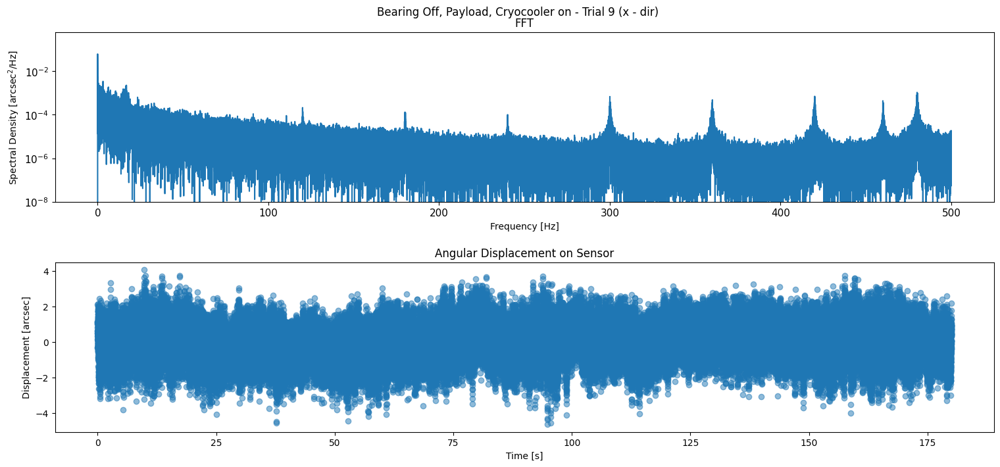

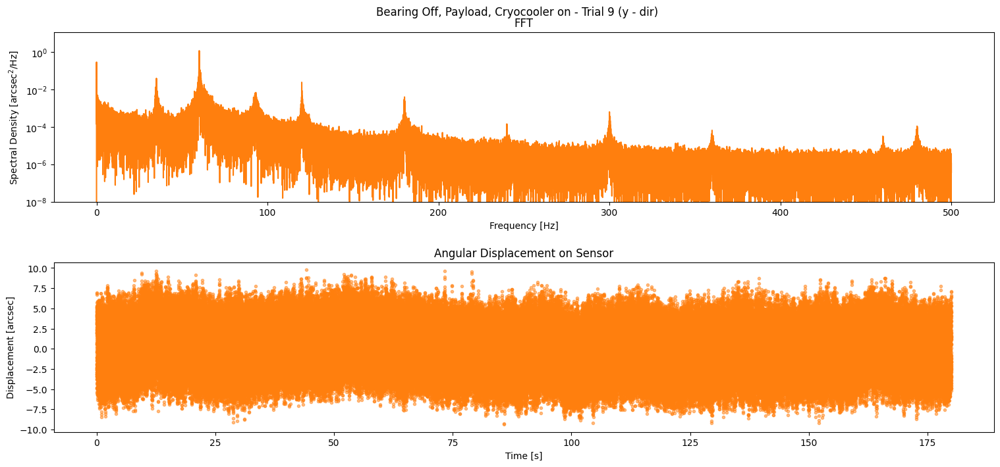

In [ ]:
bearingoff_electronicson_9_xdisp = rad_to_arcsec((bearingoff_electronicson_9_xdata - np.mean(bearingoff_electronicson_9_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_9_ydisp = rad_to_arcsec((bearingoff_electronicson_9_ydata - np.mean(bearingoff_electronicson_9_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_9_xpsc_arcsec = power_spectrum(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_xdisp)
bearingoff_electronicson_9_ypsc_arcsec = power_spectrum(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_ydisp)

plot_FFT_and_pos_angular(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_xdisp, bearingoff_electronicson_9_ydisp,
                          bearingoff_electronicson_9_xpsc_arcsec, bearingoff_electronicson_9_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 9')

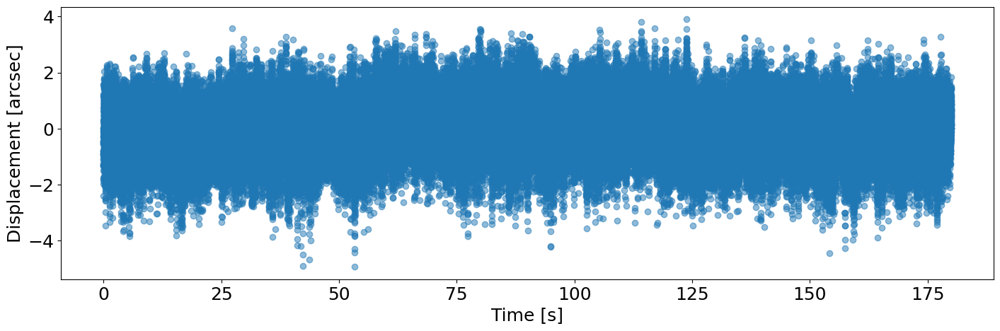

In [ ]:
ang_displacement_example_fig, ax = plt.subplots(figsize = (17,5))
ax.scatter(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_xdisp - np.mean(bearingoff_electronicson_6_xdisp)), alpha = 0.5)
#ax.set_title('Angular Displacement on Sensor',fontsize=18)
ax.set_xlabel('Time [s]', fontsize=18)
ax.set_ylabel(r'Displacement [arcsec]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

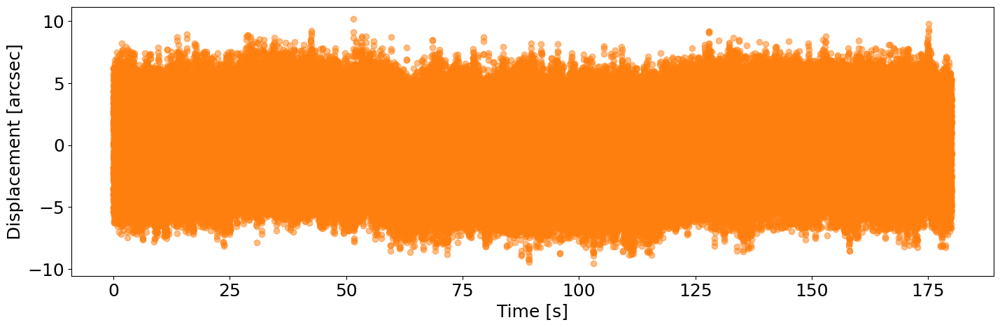

In [ ]:
ang_displacement_example_fig, ax = plt.subplots(figsize = (17,5))
ax.scatter(bearingoff_electronicson_6_tdata, (bearingoff_electronicson_6_ydisp - np.mean(bearingoff_electronicson_6_ydisp)), alpha = 0.5, c='C1')
#ax.set_title('Angular Displacement on Sensor',fontsize=18)
ax.set_xlabel('Time [s]', fontsize=18)
ax.set_ylabel(r'Displacement [arcsec]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

Let's compute the movement from frame to frame.

In [ ]:
test_xdata = bearingoff_electronicson_9_xdisp[0:21]
test_ydata = bearingoff_electronicson_9_ydisp[0:21]
test_tdata = bearingoff_electronicson_9_tdata[0:21]

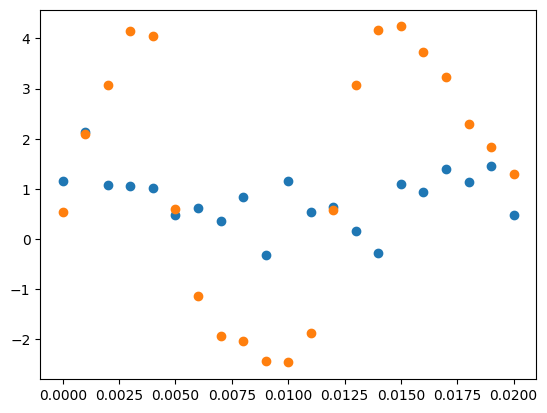

In [ ]:
plt.scatter(test_tdata, test_xdata)
plt.scatter(test_tdata, test_ydata)

In [ ]:
interpx = scipy.interpolate.CubicSpline(test_tdata, test_xdata, bc_type = 'natural')
interpy = scipy.interpolate.CubicSpline(test_tdata, test_ydata, bc_type = 'natural')

In [ ]:
test_tdata

array([0.   , 0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.007, 0.008,
       0.009, 0.01 , 0.011, 0.012, 0.013, 0.014, 0.015, 0.016, 0.017,
       0.018, 0.019, 0.02 ])

In [ ]:
new_t = np.arange(test_tdata[0], test_tdata[-1], (test_tdata[1]-test_tdata[0])/2)

In [ ]:
len(new_t)

40

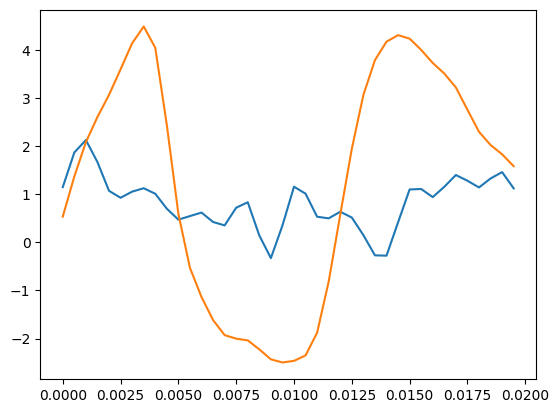

In [ ]:
plt.plot(new_t, interpx(new_t))
plt.plot(new_t, interpy(new_t))

In [ ]:
interpx(0.0005), interpy(0.0005)

(array(1.87124583), array(1.37220941))

In [ ]:
t = 0.0005
dr_array = np.zeros((1, len(new_t)))
for i in range(len(new_t)):
  #initizalize the timestep
  dt = 0.0005
  dx = (interpx(t) - interpx(t - dt))
  dy = (interpy(t) - interpy(t - dt))
  dr = np.sqrt(dx**2 + dy**2)
  dr_array[0,i] = dr
  #update t
  t += dt


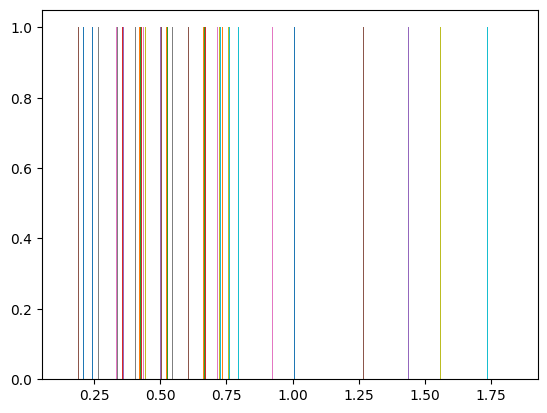

In [ ]:
plt.hist(dr_array)
plt.show()

In [ ]:
bearingoff_electronicson_9_interpx = scipy.interpolate.CubicSpline(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_xdisp, bc_type = 'natural')
bearingoff_electronicson_9_interpy = scipy.interpolate.CubicSpline(bearingoff_electronicson_9_tdata, bearingoff_electronicson_9_ydisp, bc_type = 'natural')

In [ ]:
bearingoff_electronicson_9_interpx

In [ ]:
int_time = (bearingoff_electronicson_9_tdata[1] - bearingoff_electronicson_9_tdata[0])/2
interp_t = np.arange(bearingoff_electronicson_9_tdata[0], bearingoff_electronicson_9_tdata[-1] + int_time, int_time)

In [ ]:
bearingoff_electronicson_9_dr = np.zeros((1, len(interp_t)))
t = int_time
for i in range(len(interp_t)):
  #initizalize the timestep
  dt = int_time
  dx = (bearingoff_electronicson_9_interpx(t) - bearingoff_electronicson_9_interpx(t - dt))
  dy = (bearingoff_electronicson_9_interpy(t) - bearingoff_electronicson_9_interpy(t - dt))
  dr = np.sqrt(dx**2 + dy**2)
  bearingoff_electronicson_9_dr[0,i] = dr
  #update t
  t += dt

In [ ]:
interp_t

array([0.000000e+00, 5.000000e-04, 1.000000e-03, ..., 1.799980e+02,
       1.799985e+02, 1.799990e+02])

In [ ]:
bearingoff_electronicson_9_dr.flatten()

array([1.1037766 , 0.75995122, 0.69540895, ..., 1.22114899, 1.36515419,
       1.36515442])

In [ ]:
from scipy.stats import kde

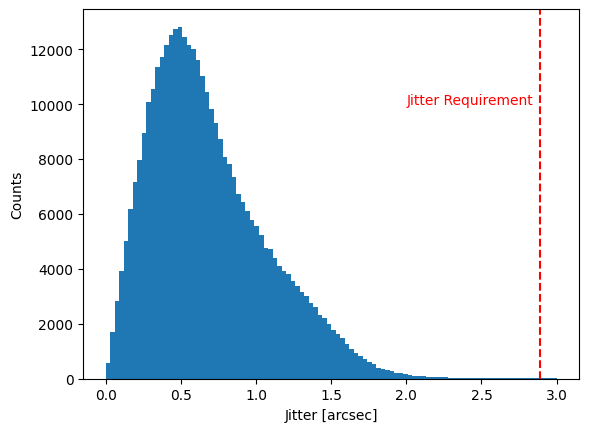

In [ ]:
plt.hist(bearingoff_electronicson_9_dr.flatten(), bins = 100, range = (0,3))
plt.axvline(2.89, ls = '--', color = 'r')
plt.text(2.0, 10000, 'Jitter Requirement', c = 'r')
#plt.title('Integration time (0.5 ms) jitter with Bearing off and Cryocooler on')
plt.xlabel('Jitter [arcsec]')
plt.ylabel('Counts')
plt.show()

<ipython-input-51-5a4d90fdd65a>:1: DeprecationWarning: Please use `gaussian_kde` from the `scipy.stats` namespace, the `scipy.stats.kde` namespace is deprecated.
  density = kde.gaussian_kde(bearingoff_electronicson_9_dr.flatten())


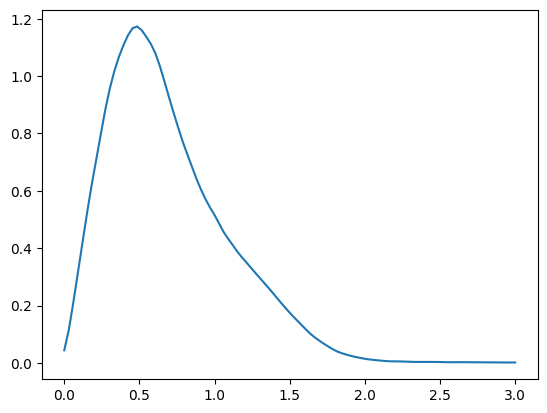

In [ ]:
density = kde.gaussian_kde(bearingoff_electronicson_9_dr.flatten())
jitter_vals = np.linspace(0,3,100)

plt.plot(jitter_vals, density(jitter_vals))
plt.show()

In [ ]:
plt.hist(bearingoff_electronicson_9_dr.flatten(), bins = 50, density = True, range = (0,3))
plt.axvline(2.89, ls = '--', color = 'r')
plt.text(2.0, 10000, 'Jitter Requirement', c = 'r')
#plt.title('Integration time (0.5 ms) jitter with Bearing off and Cryocooler on')
plt.xlabel('Jitter [arcsec]')
plt.ylabel('Counts')
plt.show()

ValueError: Image size of 567x3005135 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 640x480 with 1 Axes>

In [ ]:
bearingoff_electronicson_10 = np.genfromtxt('data_3_12_bearingoff_electronicson_10in_20230312-142947.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_10_xdata, bearingoff_electronicson_10_ydata, bearingoff_electronicson_10_vsum, bearingoff_electronicson_10_tdata = seperate_data_from(bearingoff_electronicson_10)

bearingoff_electronicson_10_xpsc = power_spectrum(bearingoff_electronicson_10_tdata, (bearingoff_electronicson_10_xdata - np.mean(bearingoff_electronicson_10_xdata)))
bearingoff_electronicson_10_ypsc = power_spectrum(bearingoff_electronicson_10_tdata, (bearingoff_electronicson_10_ydata - np.mean(bearingoff_electronicson_10_ydata)))

In [ ]:
# bearingoff_electronicson_10_plot = plot_FFT_and_pos(bearingoff_electronicson_10_tdata, bearingoff_electronicson_10_xdata, bearingoff_electronicson_10_ydata, bearingoff_electronicson_10_xpsc, bearingoff_electronicson_10_ypsc, 'Bearing Off, Payload & Cryocooler on  - Trial 10')

In [ ]:
bearingoff_electronicson_10_xdisp = rad_to_arcsec((bearingoff_electronicson_10_xdata - np.mean(bearingoff_electronicson_10_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_10_ydisp = rad_to_arcsec((bearingoff_electronicson_10_ydata - np.mean(bearingoff_electronicson_10_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_10_xpsc_arcsec = power_spectrum(bearingoff_electronicson_10_tdata, bearingoff_electronicson_10_xdisp)
bearingoff_electronicson_10_ypsc_arcsec = power_spectrum(bearingoff_electronicson_10_tdata, bearingoff_electronicson_10_ydisp)

# plot_FFT_and_pos_angular(bearingoff_electronicson_10_tdata, bearingoff_electronicson_10_xdisp, bearingoff_electronicson_10_ydisp,
#                          bearingoff_electronicson_10_xpsc_arcsec, bearingoff_electronicson_10_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 10')

In [ ]:
bearingoff_electronicson_11 = np.genfromtxt('data_3_12_bearingoff_electronicson_11in_20230312-143437.csv', delimiter = ',', skip_header = 2)
bearingoff_electronicson_11_xdata, bearingoff_electronicson_11_ydata, bearingoff_electronicson_11_vsum, bearingoff_electronicson_11_tdata = seperate_data_from(bearingoff_electronicson_11)

In [ ]:
bearingoff_electronicson_11_xpsc = power_spectrum(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_xdata - np.mean(bearingoff_electronicson_11_xdata))
bearingoff_electronicson_11_ypsc = power_spectrum(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_ydata - np.mean(bearingoff_electronicson_11_ydata))

In [ ]:
# bearingoff_electronicson_11_plot = plot_FFT_and_pos(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_xdata, bearingoff_electronicson_11_ydata, bearingoff_electronicson_11_xpsc, bearingoff_electronicson_11_ypsc, 'Bearing off, Payload & Cryo on Trial 11')

In [ ]:
bearingoff_electronicson_11_xdisp = rad_to_arcsec((bearingoff_electronicson_11_xdata - np.mean(bearingoff_electronicson_11_xdata)) / bearingoff_electronicson_throw_distance)
bearingoff_electronicson_11_ydisp = rad_to_arcsec((bearingoff_electronicson_11_ydata - np.mean(bearingoff_electronicson_11_ydata)) / bearingoff_electronicson_throw_distance)

bearingoff_electronicson_11_xpsc_arcsec = power_spectrum(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_xdisp)
bearingoff_electronicson_11_ypsc_arcsec = power_spectrum(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_ydisp)

# plot_FFT_and_pos_angular(bearingoff_electronicson_11_tdata, bearingoff_electronicson_11_xdisp, bearingoff_electronicson_11_ydisp,
#                          bearingoff_electronicson_11_xpsc_arcsec, bearingoff_electronicson_11_ypsc_arcsec, 'Bearing Off, Payload, Cryocooler on - Trial 11')

## Find the average PSD of the angular displacement plots

Next, we find  the average value of the psd plots and then plot those values. I didn't think that the method above seemed like the most appropiate way to do it, so below is the right way.

In [ ]:
bearingoff_electronicson_freqs = pd.DataFrame(bearingoff_electronicson_10_xpsc[0])
#we can assume that the frequency bins of the other data sets are the same since the sampling is the same.

In [ ]:
bearingoff_electronicson_xspec_powers = pd.DataFrame([bearingoff_electronicson_6_xpsc_arcsec[1], bearingoff_electronicson_7_xpsc_arcsec[1],bearingoff_electronicson_8_xpsc_arcsec[1],
                                                      bearingoff_electronicson_9_xpsc_arcsec[1], bearingoff_electronicson_10_xpsc_arcsec[1], bearingoff_electronicson_11_xpsc_arcsec[1]])
bearingoff_electronicson_yspec_powers = pd.DataFrame([bearingoff_electronicson_6_ypsc_arcsec[1], bearingoff_electronicson_7_ypsc_arcsec[1],bearingoff_electronicson_8_ypsc_arcsec[1],
                                                      bearingoff_electronicson_9_ypsc_arcsec[1], bearingoff_electronicson_10_ypsc_arcsec[1], bearingoff_electronicson_11_ypsc_arcsec[1]])

In [ ]:
bearingoff_electronicson_xspec_avgs = bearingoff_electronicson_xspec_powers.mean(axis = 0)
bearingoff_electronicson_xspec_sem = bearingoff_electronicson_xspec_powers.sem(axis = 0)
bearingoff_electronicson_yspec_avgs = bearingoff_electronicson_yspec_powers.mean(axis = 0)
bearingoff_electronicson_yspec_sem = bearingoff_electronicson_yspec_powers.sem(axis = 0)

In [ ]:
#write these avgs and sem to csv file
bearingoff_electronicson_xspec_avgs.to_csv('bearingoff_electronicson_x_avgs.csv')
bearingoff_electronicson_xspec_sem.to_csv('bearingoff_electronicson_x_sem.csv')
bearingoff_electronicson_yspec_avgs.to_csv('bearingoff_electronicson_y_avgs.csv')
bearingoff_electronicson_yspec_sem.to_csv('bearingoff_electronicson_y_sem.csv')

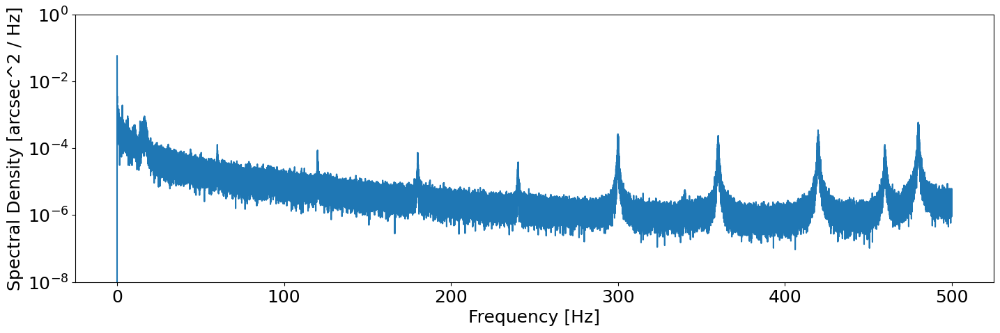

In [ ]:
avged2_x_bearingoff_electronicson_fig, ax = plt.subplots(figsize=(17,5))
#ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75)
ax.plot(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, c='C0')
ax.set_ylim(1e-8,1e0)
ax.set_yscale('log')
#ax.set_xlim(299,301)
#ax.set_title('Configuration 1 (In-Track direction)')
ax.set_xlabel('Frequency [Hz]', fontsize=18)
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

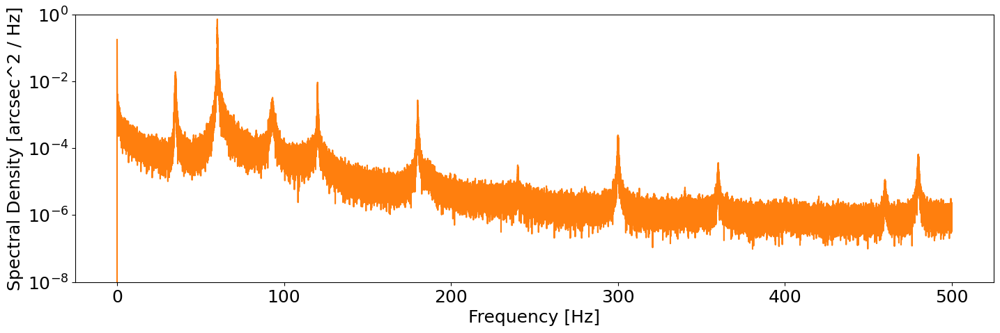

In [ ]:
avged2_y_bearingoff_electronicson_fig, ax = plt.subplots(figsize = (17,5))
#ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75)
ax.plot(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs,c='C1')
ax.set_ylim(1e-8,1e0)
ax.set_yscale('log')
#ax.set_xlim(59,61)
#ax.set_title('Bearing off & Electronics on (y - direction)')
ax.set_xlabel('Frequency [Hz]', fontsize=18)
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]', fontsize=18)
ax.tick_params(axis='both', which = 'major', labelsize=18)
ax.tick_params(axis='both', which = 'minor', labelsize=18)

Text(0, 0.5, 'Spectral Density [arcsec^2 / Hz]')

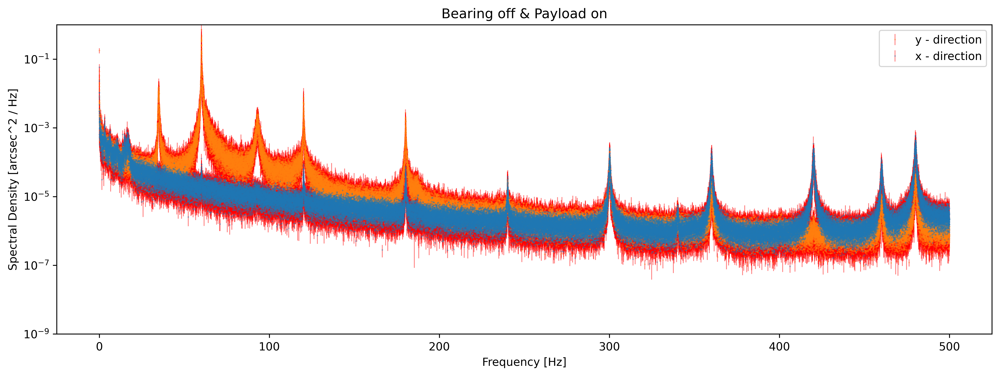

In [ ]:
#make a plot that overlays both
overlayed_fig, ax = plt.subplots(figsize = (15,5), dpi = 600)
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'y - direction', markersize = 0.75)
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'x - direction', markersize=0.75)
ax.set_ylim(1e-9,1e0)
ax.set_yscale('log')
#ax.set_xlim(59,61)
ax.set_title('Bearing off & Payload on')
ax.set_xlabel('Frequency [Hz]')
ax.legend()
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

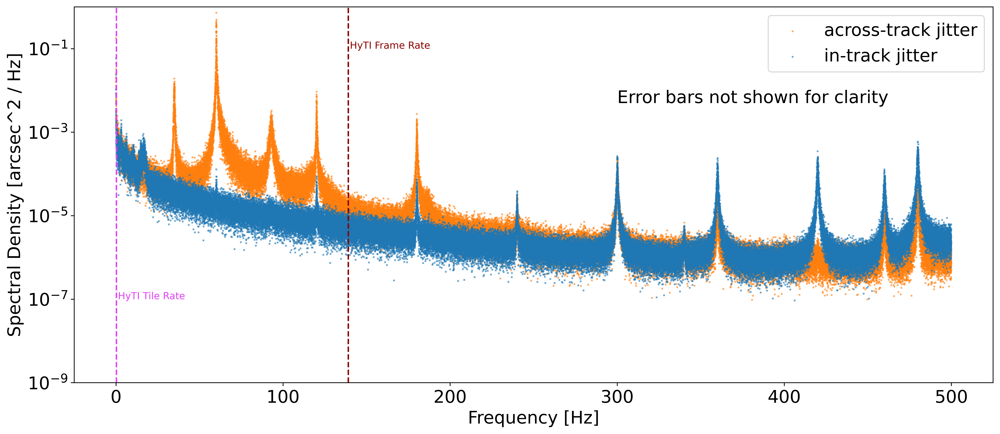

In [ ]:
#make a plot that overlays both
# Remove the error bars?

overlayed_fig, ax1 = plt.subplots(figsize = (17,7), dpi = 600)
ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, marker = ',', color = 'C1', alpha = 0.5, label = 'across-track jitter', s = 0.75)
ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, marker = ',', color = 'C0', alpha = 0.5, label = 'in-track jitter', s = 0.75)
# ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'y - direction', markersize = 0.75)
# ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'x - direction', markersize=0.75)
ax1.set_ylim(1e-9,1e0)
ax1.set_yscale('log')
#ax.set_xlim(59,61)
ax1.axvline(x = 139, ymin = 1e-9, ymax = 1e0, ls = '--', c = 'darkred')
ax1.text(x = 140, y = 1e-1, s = 'HyTI Frame Rate', c = 'darkred')
ax1.axvline(x = 0.2, ymin = 1e-9, ymax = 1e0, ls = '--', c = '#e342f5')
ax1.text(x = 1.2, y= 1e-7, s = 'HyTI Tile Rate', c ='#e342f5')
#ax1.set_title('Bearing off & Payload on')
ax1.set_xlabel('Frequency [Hz]',fontsize=18)
ax1.legend(prop={"size":18})
ax1.set_ylabel('Spectral Density [arcsec^2 / Hz]',fontsize=18)
ax1.text(300, 5e-3, 'Error bars not shown for clarity', fontsize = 18)
ax1.tick_params(axis='both', which = 'major', labelsize=18)
ax1.tick_params(axis='both', which = 'minor', labelsize=18)

<ipython-input-46-d4ffde2e9e6a>:33: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in legend.legendHandles:


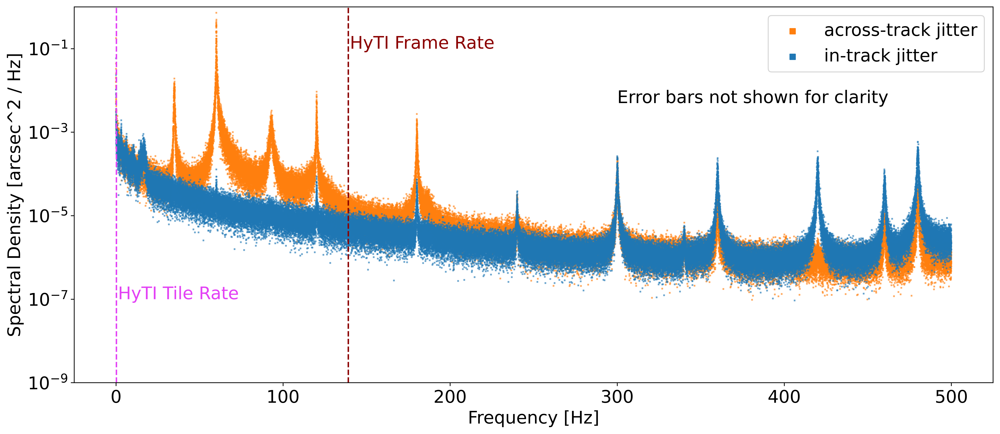

In [ ]:
# Create a custom legend handler
from matplotlib.legend_handler import HandlerTuple
class HandlerAlphaTuple(HandlerTuple):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        artists = HandlerTuple.create_artists(self, legend, orig_handle,
                                              xdescent, ydescent, width, height, fontsize, trans)
        for artist in artists:
            if hasattr(artist, 'set_alpha'):
                artist.set_alpha(1)
        return artists

# Create your scatter plot
overlayed_fig, ax1 = plt.subplots(figsize=(17, 7), dpi=600)
ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, marker=',', color='C1', alpha=0.5, label='across-track jitter', s=0.75)
ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, marker=',', color='C0', alpha=0.5, label='in-track jitter', s=0.75)

# Customize plot elements
ax1.set_ylim(1e-9, 1e0)
ax1.set_yscale('log')
ax1.axvline(x=139, ymin=1e-9, ymax=1e0, ls='--', c='darkred')
ax1.text(x=140, y=1e-1, s='HyTI Frame Rate', c='darkred',fontsize=18)
ax1.axvline(x=0.2, ymin=1e-9, ymax=1e0, ls='--', c='#e342f5')
ax1.text(x=1.2, y=1e-7, s='HyTI Tile Rate', c='#e342f5',fontsize=18)
ax1.set_xlabel('Frequency [Hz]', fontsize=18)
ax1.set_ylabel('Spectral Density [arcsec^2 / Hz]', fontsize=18)
ax1.text(300, 5e-3, 'Error bars not shown for clarity', fontsize=18)
ax1.tick_params(axis='both', which='major', labelsize=18)
ax1.tick_params(axis='both', which='minor', labelsize=18)

# Add legend with custom handler
legend = ax1.legend(handler_map={tuple: HandlerAlphaTuple()}, prop={"size": 18})
for handle in legend.legendHandles:
    handle.set_sizes([30])  # Adjust the size as needed
    handle.set_alpha(1)
plt.show()

Text(0, 1e-07, 'Error bars not shown for clarity')

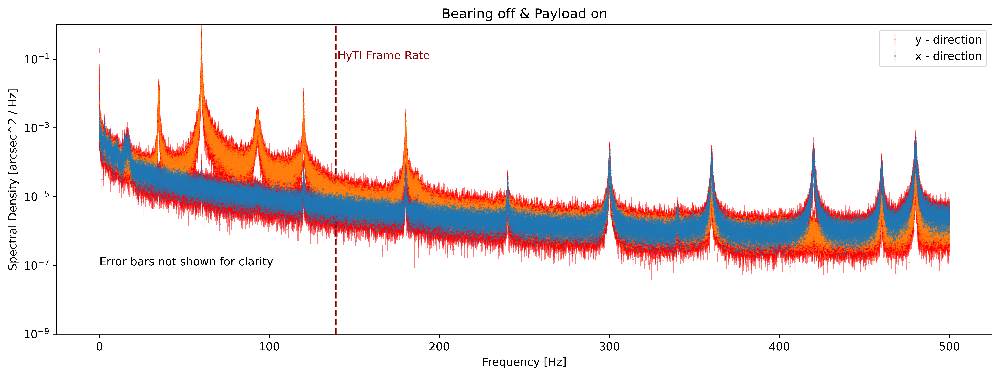

In [ ]:
#make a plot that overlays both
# Remove the error bars?

bearingoff_payload_on_xfig, ax2 = plt.subplots(figsize = (15,5), dpi = 600)
#ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, marker = ',', color = 'C1', alpha = 0.5, label = 'across-track jitter', s = 0.75)
#ax1.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, marker = ',', color = 'C0', alpha = 0.5, label = 'in-track jitter', s = 0.75)
ax2.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'y - direction', markersize = 0.75)
ax2.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'x - direction', markersize=0.75)
ax2.set_ylim(1e-9,1e0)
ax2.set_yscale('log')
#ax.set_xlim(59,61)
ax2.axvline(x = 139, ymin = 1e-9, ymax = 1e0, ls = '--', c = 'darkred')
ax2.text(x = 140, y = 1e-1, s = 'HyTI Frame Rate', c = 'darkred')
ax2.set_title('Bearing off & Payload on')
ax2.set_xlabel('Frequency [Hz]')
ax2.legend()
ax2.set_ylabel('Spectral Density [arcsec^2 / Hz]')
ax2.text(0, 1e-7, 'Error bars not shown for clarity', fontsize = 10)

Text(0, 0.5, 'Spectral Density [arcsec^2 / Hz]')

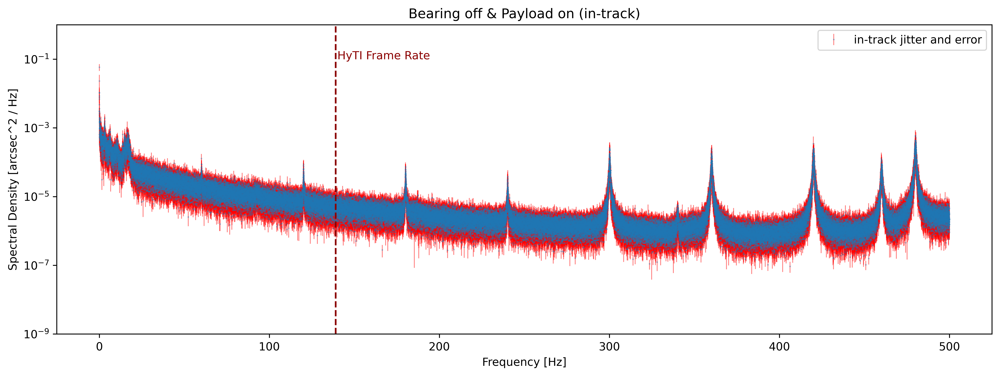

In [ ]:
bearingoff_payload_on_xfig, ax2 = plt.subplots(figsize = (15,5), dpi = 600)
# ax.scatter(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'y - direction', markersize = 0.75)
ax2.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'in-track jitter and error', markersize=0.75, zorder = 1)
ax2.set_ylim(1e-9,1e0)
ax2.set_yscale('log')
#ax2.set_xlim(59,61)
ax2.axvline(x = 139, ymin = 1e-9, ymax = 1e0, ls = '--', c = 'darkred', zorder = 2)
ax2.text(x = 140, y = 1e-1, s = 'HyTI Frame Rate', c = 'darkred')
ax2.set_title('Bearing off & Payload on (in-track)')
ax2.set_xlabel('Frequency [Hz]')
ax2.legend()
ax2.set_ylabel('Spectral Density [arcsec^2 / Hz]')

In [ ]:
bearingoff_payload_on_yfig, ax3 = plt.subplots(figsize = (15,5), dpi = 600)
ax3.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'across-track jitter and error', markersize = 0.75, zorder = 0)
#ax2.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, alpha = 0.5, label = 'yaw jitter and error', markersize=0.75)
ax3.set_ylim(1e-9,1e0)
ax3.set_yscale('log')
#ax2.set_xlim(59,61)
ax3.axvline(x = 139, ymin = 1e-9, ymax = 1e0, ls = '--', c = 'darkred', zorder = 2)
ax3.text(x = 140, y = 1e-1, s = 'HyTI Frame Rate', c = 'darkred')
ax3.set_title('Bearing off & Payload on (across-track)')
ax3.set_xlabel('Frequency [Hz]')
ax3.legend()
ax3.set_ylabel('Spectral Density [arcsec^2 / Hz]')

Text(0, 0.5, 'Spectral Density [arcsec^2 / Hz]')

Error in callback <function flush_figures at 0x7cf684138280> (for post_execute):


KeyboardInterrupt: 

We want to evaluate the integral of the

In [ ]:
#make a dataframe with the data
xdata = np.asarray(bearingoff_electronicson_freqs.iloc[25020:]).flatten()

In [ ]:
ydata = np.asarray(bearingoff_electronicson_xspec_avgs.iloc[25020:]).flatten()

In [ ]:
np.shape(xdata), np.shape(ydata)

((64980,), (64980,))

In [ ]:
bearingoff_electronicson_x_jitter = np.sqrt(scipy.integrate.trapezoid(np.asarray(bearingoff_electronicson_xspec_avgs.iloc[25020:]).flatten(), np.asarray(bearingoff_electronicson_freqs.iloc[25020:]).flatten()))
bearingoff_electronicson_y_jitter = np.sqrt(scipy.integrate.trapezoid(np.asarray(bearingoff_electronicson_yspec_avgs.iloc[25020:]).flatten(), np.asarray(bearingoff_electronicson_freqs.iloc[25020:]).flatten()))

In [ ]:
bearingoff_electronicson_x_jitter, bearingoff_electronicson_y_jitter

(0.040174895747356464, 0.04571363366631322)

In [ ]:
np.shape(bearingoff_electronicson_xspec_avgs.iloc[25020:]), np.shape(bearingoff_electronicson_freqs.iloc[25020:,0])

((64980,), (64980,))

In [ ]:
bearingoff_electronicson_freqs.iloc[25020:, 0]

25020    139.000000
25021    139.005556
25022    139.011111
25023    139.016667
25024    139.022222
            ...    
89995    499.972222
89996    499.977778
89997    499.983333
89998    499.988889
89999    499.994444
Name: 0, Length: 64980, dtype: float64

In [ ]:
bearingoff_electronicson_x_tilejitter = np.sqrt(scipy.integrate.trapezoid(np.asarray(bearingoff_electronicson_xspec_avgs.iloc[36:]).flatten(), np.asarray(bearingoff_electronicson_freqs.iloc[36:]).flatten()))
bearingoff_electronicson_y_tilejitter = np.sqrt(scipy.integrate.trapezoid(np.asarray(bearingoff_electronicson_yspec_avgs.iloc[36:]).flatten(), np.asarray(bearingoff_electronicson_freqs.iloc[36:]).flatten()))

In [ ]:
bearingoff_electronicson_x_tilejitter, bearingoff_electronicson_y_tilejitter

(0.0928608673115518, 0.364668026155405)

In [ ]:
jitter_req = plt.Circle((np.mean(bearingoff_electronicson_1_xdisp), np.mean(bearingoff_electronicson_1_ydisp)), 2.89, ls = '--', fill=False, ec = 'red', zorder = 2, label = 'Jitter Req.')
bearingoff_electronicsoff_track, ax1 = plt.subplots(figsize = (5,5))
ax1.plot(bearingon_electronicsoff_1_xdisp, bearingoff_electronicsoff_1_ydisp, lw = 0.01, alpha = 0.5, zorder = 1, label = 'Trial 1 Data')
ax1.set_ylim(-5,5)
ax1.set_xlim(-5,5)
ax1.add_patch(jitter_req)
ax1.set_xlabel('in-track jitter [arcsec]')
ax1.set_ylabel('across-track jitter [arcsec]')
ax1.legend()


NameError: name 'bearingoff_electronicson_1_xdisp' is not defined

# Run MLE Estimator for establishing error on your measurements

In [ ]:
# x = freqs

# def lorentzianoffset(x, x0, A, gamma, y0):
#   """ Lorentzian function centered at x0 with the amplitude A and FWHM gamma"""
#   return y0 + (A *gamma**2 / (gamma**2 + (x-x0)**2))

# def lorentzian(x,x0, A, gamma):
#   """ Lrentzian function centered at x0 with amplitude A and FWHM gamma"""
#   return (A*gamma**2 / (gamma**2 + (x - x0)**2))

# def rms(y, yfit):
#     return np.sqrt(np.sum((y-yfit)**2))

# # Unweighted fit
# p0 = 35, 0.015, 0.1, 1e-5
# popt, pcov = curve_fit(lorentzianoffset, x, bearingoff_electronicson_yspec_avgs_60hz, p0)
# yfit = lorentzianoffset(x, *popt)
# print('Unweighted fit parameters:', popt)
# print('Covariance matrix:'); print(pcov)
# print('rms error in fit:', rms(bearingoff_electronicson_yspec_avgs_60hz, yfit))
# print()

# # # Weighted fit
# popt2, pcov2 = curve_fit(lorentzianoffset, x, bearingoff_electronicson_yspec_avgs_60hz, p0, sigma=bearingoff_electronicson_yspec_sem_60hz, absolute_sigma=True)
# yfit2 = lorentzianoffset(x, *popt2)
# print('Weighted fit parameters:', popt2)
# print('Covariance matrix:'); print(pcov2)
# print('rms error in fit:', rms(bearingoff_electronicson_yspec_avgs_60hz, yfit2))

# #Let's try this again using scipy.optimize least squares function
# def residuals(parameters, x, y):
#   return lorentzianoffset(x, parameters[0], parameters[1], parameters[2], parameters[3]) - y

# #fit with least squares
# popt_3, ier = leastsq(residuals, p0, args = (x, bearingoff_electronicson_yspec_avgs_60hz))
# print('SciPy Leastsq Method:', popt_3)
# #plt.plot(x, lorentzian(x, *popt_3), label = 'scipy optimize LS')


# plt.figure(figsize = (15,5))
# plt.errorbar(x, bearingoff_electronicson_yspec_avgs_60hz , yerr = bearingoff_electronicson_yspec_sem_60hz, fmt =  '.', c = 'C1', ecolor = 'red', elinewidth = 0.75, label='Noisy data', zorder = 0)
# plt.plot(x, yfit, 'C4', lw = 1.5, label='Unweighted fit')
# plt.plot(x, yfit2, 'C5', lw = 1.5, label='Weighted fit')
# plt.plot(x, lorentzianoffset(x, *popt_3), 'C6', label = 'scipy optimize LS')
# plt.xlabel('Frequency [Hz]')
# plt.ylabel('Power Spectral Density [arcsec^2/Hz]')
# #pylab.ylim(-1,4)
# plt.legend()
# plt.show()


In [ ]:
# #make an array of sampled values?
# test_array = np.zeros(np.shape(bearingoff_electronicson_yspec_avgs_60hz))
# for i in range(len(bearingoff_electronicson_yspec_avgs_60hz)):
#   test_array[i] = bearingoff_electronicson_yspec_avgs_60hz[i] + np.random.choice([-1,1])*np.random.choice(normed_chi2)* bearingoff_electronicson_yspec_sem_60hz[i]

In [ ]:
# from scipy.optimize import minimize

# def neglnlike(parameters, x, y):
#     #h/t James Kuszlewicz
#     #Data is the actual averages fitted about a Lorentzian
#     model = lorentzian(x, parameters[0], parameters[1], parameters[2])
#     output = np.sum(np.log(model) + y/model)
#     #Check that this is valid, returning large number if not
#     if not np.isfinite(output):
#         return 1.0e30
#     return output

# res = minimize(neglnlike, p0, args=(x,bearingoff_electronicson_yspec_avgs_60hz),
#               method='Nelder-Mead')

In [ ]:
# plt.figure(figsize = (15,5))
# plt.errorbar(x, bearingoff_electronicson_yspec_avgs_60hz , yerr = bearingoff_electronicson_yspec_sem_60hz, fmt =  '.', c = 'C1', ecolor = 'red', elinewidth = 0.75, label='Noisy data', zorder = 0)
# plt.plot(x, yfit, 'C4', lw = 1.5, label='Unweighted fit')
# plt.plot(x, yfit2, 'C5', lw = 1.5, label='Weighted fit')
# plt.plot(x, lorentzian(x, *popt_3), 'C6', label = 'scipy optimize LS')
# plt.plot(x, lorentzian(x, *res.x), 'k--', label = 'MLE')
# plt.xlabel('Frequency [Hz]')
# plt.ylabel('Power Spectral Density [arcsec^2/Hz]')
# #pylab.ylim(-1,4)
# plt.legend()
# plt.show()

# print(res.x)

In [ ]:
# res_test_data = minimize(neglnlike, p0, args=(x, test_array),
#               method='Nelder-Mead')


In [ ]:
# plt.figure(figsize = (15,5))
# plt.errorbar(x, bearingoff_electronicson_yspec_avgs_60hz , yerr = bearingoff_electronicson_yspec_sem_60hz, fmt =  '.', c = 'C1', ecolor = 'red', elinewidth = 0.75, label='Noisy data', zorder = 0)
# # plt.plot(x, yfit, 'C4', lw = 1.5, label='Unweighted fit')
# # plt.plot(x, yfit2, 'C5', lw = 1.5, label='Weighted fit')
# # plt.plot(x, lorentzian(x, *popt_3), 'C6', label = 'scipy optimize LS')
# plt.plot(x, lorentzian(x, *res.x), 'k--', label = 'MLE - real data')
# plt.plot(x, lorentzian(x, *res_test_data.x), 'g--', label = 'MLE - test data')
# plt.plot(x, test_array, 'C0.', label = 'simulated points')
# plt.xlabel('Frequency [Hz]')
# plt.ylabel('Power Spectral Density [arcsec^2/Hz]')
# #pylab.ylim(-1,4)
# plt.legend()
# plt.show()

# print(res_test_data.x)


In [ ]:
# #Also run a ton of simulations for the MLE treatment
# nruns = 10000
# #Prepare to collect the results
# mleresults = np.zeros((nruns,3))
# #Keep track of any fits that don't converge
# mlebad = np.zeros(nruns)
# #Simulate and fit
# for i in range(nruns):

#   data = np.zeros(np.shape(bearingoff_electronicson_yspec_avgs_60hz))

#   for j in range(len(bearingoff_electronicson_yspec_avgs_60hz)):
#     data[j] = bearingoff_electronicson_yspec_avgs_60hz[j] + np.random.choice([-1,1])*np.random.choice(normed_chi2)* bearingoff_electronicson_yspec_sem_60hz[j]

#   res = minimize(neglnlike, p0, args=(x, data),
#             method='Nelder-Mead')
#   if res.success: #Did the fit converge?
#       mleresults[i,:] = res.x
#   else:
#       mleresults[i,:] = np.nan
#       mlebad[i] = 1

# #Remove results from unconverged fits
# mleresults = mleresults[np.where(mlebad == 0)[0],:]

In [ ]:
# import corner

# #Corner plot the two types of solutions
# # labels=['center','amplitude','fwhm']
# # ranges = [[119,121],[0, 1e-2],[0,5e-4]]
# # bins = [np.arange(119,121,.01),
# #        np.arange(0,1e-2,1e-4),
# #        np.arange(0,5e-4,1e-5)]
# #Good fits, with summary stats in title
# figure = plt.figure(figsize = (15,15))
# figure = corner.corner(mleresults, labels  = ['center', 'amp', 'fwhm'],
#                       show_titles = True, title_fmt = '.4g')
#                       # truths = p0, range=ranges, show_titles=True,
#                     #   color='black')

# plt.show()

In [ ]:
# plt.figure(figsize = (15,5))
# plt.errorbar(x, bearingoff_electronicson_yspec_avgs_60hz , yerr = bearingoff_electronicson_yspec_sem_60hz, fmt =  '.', c = 'C1', ecolor = 'red', elinewidth = 0.75, label='Noisy data', zorder = 0)
# plt.plot(x, yfit, 'C4', lw = 1.5, label='Unweighted fit')
# plt.plot(x, yfit2, 'C5', lw = 1.5, label='Weighted fit')
# plt.plot(x, lorentzian(x, *popt_3), 'C6', label = 'scipy optimize LS')
# plt.plot(x, lorentzian(x, 60.11, 0.06593, 0.127), 'k--', label = 'MLE')
# plt.xlabel('Frequency [Hz]')
# plt.ylabel('Power Spectral Density [arcsec^2/Hz]')
# #pylab.ylim(-1,4)
# plt.legend()
# plt.show()
# plt.close()


In [ ]:
import scipy.signal

# Find Peaks for Bearing off & Payload On

To find the peaks, plot out all the values and then find the sigma detection thresholds

In [ ]:
bearingoff_electronicson_xpeaks = do_science(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, bearingoff_electronicson_xspec_sem, False)

In [ ]:
bearingoff_electronicson_ypeaks = do_science(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, bearingoff_electronicson_yspec_sem, False)

Text(0, 0.5, 'Spectral Density [arcsec^2 / Hz]')

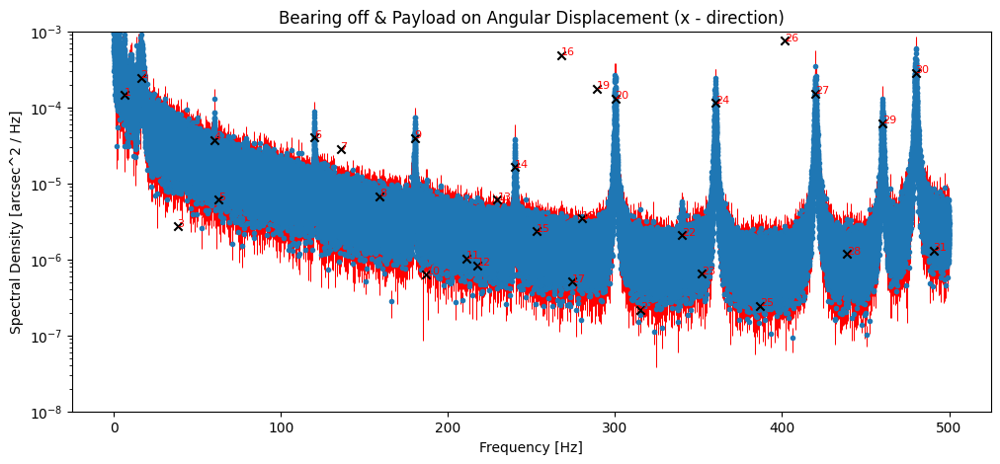

In [ ]:
bearingoff_electronicson_xpeaks_fig, ax = plt.subplots(figsize = (12,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, zorder = 0)
ax.set_ylim(1e-8,1e-3)
ax.set_yscale('log')
ax.scatter(bearingoff_electronicson_xpeaks[:,0], bearingoff_electronicson_xpeaks[:,1], marker = 'x', color = 'k', zorder = 1)
for index in range(len(bearingoff_electronicson_xpeaks[:,0])):
    if bearingoff_electronicson_xpeaks[index, 1] < 1e-3:
      ax.text(bearingoff_electronicson_xpeaks[index,0], bearingoff_electronicson_xpeaks[index,1], str(index), fontsize = 8, color = 'red')
    else:
      continue
ax.set_title('Bearing off & Payload on Angular Displacement (x - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

In [ ]:
x_peaks = [2,4,6,9,14,20,22,24,27,29,30]

Text(0, 0.5, 'Spectral Density [arcsec^2 / Hz]')

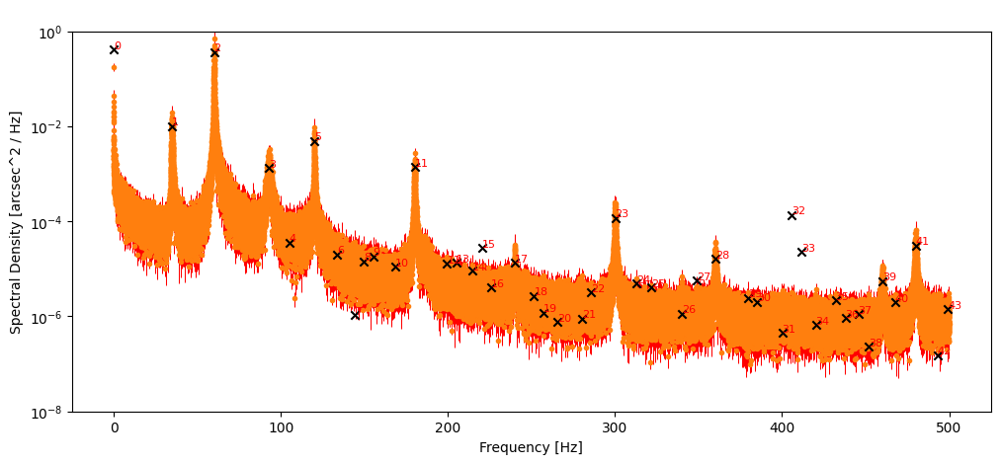

In [ ]:
bearingoff_electronicson_ypeaks_fig, ax = plt.subplots(figsize = (12,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, zorder = 0)
ax.set_ylim(1e-8,10e-1)
ax.set_yscale('log')
#ax.set_xlim(59,61)
for index in range(len(bearingoff_electronicson_ypeaks[:,0])):
    if bearingoff_electronicson_ypeaks[index, 1] < 10e-1:
      ax.text(bearingoff_electronicson_ypeaks[index,0], bearingoff_electronicson_ypeaks[index,1]*(1.05), str(index), fontsize = 8, color = 'red')
    else:
      continue
ax.scatter(bearingoff_electronicson_ypeaks[:,0], bearingoff_electronicson_ypeaks[:,1], marker = 'x', color = 'k', zorder = 1)
ax.set_title(' ')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

In [ ]:
y_peaks = [1,2,3,5,11,17,23,28,39,41]

now let's make sure we can keep all the points that we actually care about.

In [ ]:
from scipy.integrate import quad

In [ ]:
def keep_peaks_and_int_from(indicies_list, result_array, array_name):
  """ filters out peaks that user wishes to keep and writes them to csv file with the headers
  as described in the write array to csv function """

  fit_margin = 6

  final_array = np.zeros((len(indicies_list), 10))

  for i in range(len(indicies_list)):
    fit_values = result_array[indicies_list[i],:]

    I = quad(lorentzianoffset, fit_values[0] - fit_margin, fit_values[0]+fit_margin, args=(fit_values[0], fit_values[1], fit_values[2], fit_values[3]))

    I_err = I[1] #Abs error in integral
    #Offset_var = fit_values[7] #offset variance

   # I_offset = (2*fit_margin)*fit_values[3] #subtract off the area formed by the offset
    #I_offset = 0
    I_final = I[0]# - np.abs(I_offset)

    pointing_err = np.sqrt(I_final) #the root in RMS
    prop_err = I_err #+ Offset_var #since these are variances, they just add

    final_array[i] = *result_array[indicies_list[i],:], pointing_err, prop_err #append to array

  write_array_to_csv(np.abs(final_array), array_name)


  return final_array

In [ ]:
# For the
bearingoff_electronicson_real_xpeaks = keep_peaks_from(x_peaks, bearingoff_electronicson_xpeaks, 'Bearingoff_Payloadon_x.csv')
bearingoff_electronicson_real_ypeaks = keep_peaks_from(y_peaks, bearingoff_electronicson_ypeaks, 'Bearingoff_Payloadon_y.csv')

In [ ]:
bearingoff_electronicson_test_xpeaks = keep_peaks_and_int_from(x_peaks, bearingoff_electronicson_xpeaks, 'test_x_offset_subtracted_fitmar6.csv')
bearingoff_electronicson_test_ypeaks = keep_peaks_and_int_from(y_peaks, bearingoff_electronicson_ypeaks, 'test_y_offset_subtracted_fitmar6.csv')

NameError: name 'quad' is not defined

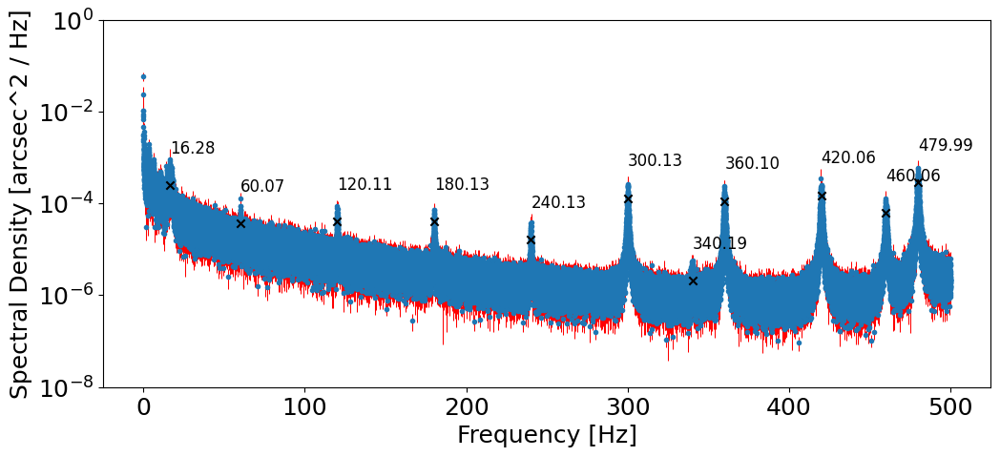

In [ ]:
bearingoff_electronicson_xpeaks_fig, ax = plt.subplots(figsize = (12,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs, yerr= bearingoff_electronicson_xspec_sem, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75, zorder = 0)
ax.set_ylim(1e-8,1e-0)
ax.set_yscale('log')
ax.scatter(bearingoff_electronicson_real_xpeaks[:,0], bearingoff_electronicson_real_xpeaks[:,1], marker = 'x', color = 'k', zorder = 1)
for index in range(len(bearingoff_electronicson_real_xpeaks[:,0])):
   ax.text(bearingoff_electronicson_real_xpeaks[index,0], 5*bearingoff_electronicson_real_xpeaks[index,1], "{:.2f}".format(bearingoff_electronicson_real_xpeaks[index,0]), fontsize = 12, color = 'k')
#ax.set_title('Bearing off & Payload on PSD (in-track)')
ax.set_xlabel('Frequency [Hz]',fontsize=18)
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]',fontsize=18)
ax.tick_params(axis='both', which='major', labelsize=18)
ax.tick_params(axis='both', which='minor', labelsize=18)

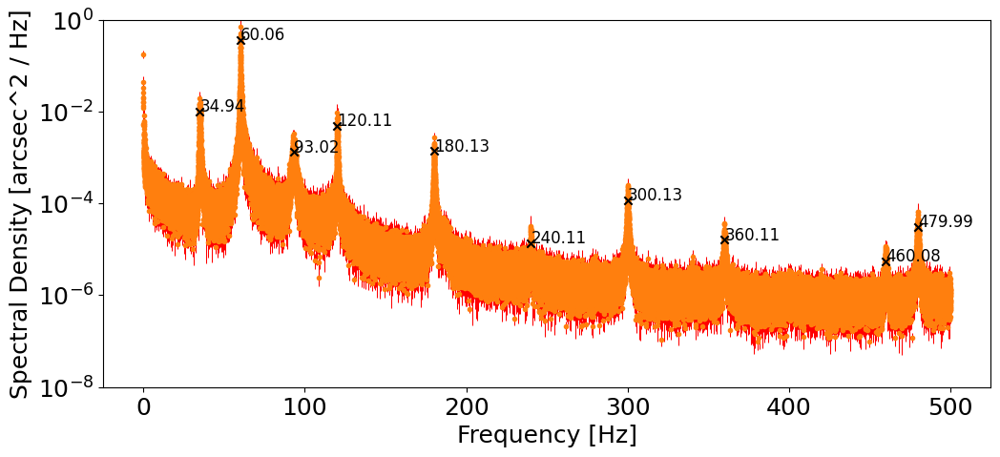

In [ ]:
bearingoff_electronicson_ypeaks_fig, ax = plt.subplots(figsize = (12,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs, yerr= bearingoff_electronicson_yspec_sem, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75, zorder = 0)
ax.set_ylim(1e-8,1e-0)
ax.set_yscale('log')
ax.scatter(bearingoff_electronicson_real_ypeaks[:,0], bearingoff_electronicson_real_ypeaks[:,1], marker = 'x', color = 'k', zorder = 1)
for index in range(len(bearingoff_electronicson_real_ypeaks[:,0])):
   ax.text(bearingoff_electronicson_real_ypeaks[index,0], bearingoff_electronicson_real_ypeaks[index,1], "{:.2f}".format(bearingoff_electronicson_real_ypeaks[index,0]), fontsize = 12, color = 'k')
#ax.set_title('Bearing off & Payload on PSD (in-track)')
ax.set_xlabel('Frequency [Hz]',fontsize=18)
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]', fontsize=18)
ax.tick_params(axis='both', which='major', labelsize=18)
ax.tick_params(axis='both', which='minor', labelsize=18)

In [ ]:
bearingoff_electronicson_real_xpeaks

array([[1.62831357e+01, 2.45214722e-04, 1.45743161e+00, 7.13634622e-05,
        1.36205982e-03, 4.43853110e-11, 6.81014213e-03, 1.95640294e-11],
       [6.00740918e+01, 3.72866811e-05, 9.40550769e-02, 1.82043379e-05,
        3.18800265e-05, 5.01411840e-12, 6.70222933e-05, 3.40645097e-14],
       [1.20110850e+02, 4.04681912e-05, 1.22968142e-01, 7.01216885e-06,
        8.45054460e-06, 9.15088184e-13, 1.80457821e-05, 8.38572468e-15],
       [1.80129918e+02, 3.98358193e-05, 1.64611090e-01, 3.63693414e-06,
        6.84981498e-06, 4.01141279e-13, 1.49636250e-05, 5.14578079e-15],
       [2.40133865e+02, 1.64245557e-05, 2.34706564e-01, 1.92019078e-06,
        1.82849087e-05, 8.95696094e-14, 4.15255839e-05, 1.76730838e-15],
       [3.00130561e+02, 1.30642367e-04, 2.80281861e-01, 2.41463576e-06,
        1.62538582e-05, 3.53197302e-12, 3.78731336e-05, 8.74778052e-14],
       [3.40193110e+02, 2.09773994e-06, 3.28031850e-01, 1.03768261e-06,
        1.49832223e-04, 6.13115109e-15, 3.58759063e-04, 1.

In [ ]:
def plot_peaks(peaks_to_plot, freqs, original_psd, original_psd_err, plot_title, dir):

  if dir == 'x':
    point_fmt = 'C0.'
  elif dir == 'y':
    point_fmt = 'C1.'
  plt.close()

  fig, ax = plt.subplots(figsize = (12,5))
  ax.errorbar(freqs, original_psd, yerr= original_psd_err, fmt = point_fmt, ecolor = 'red', elinewidth = 0.75, zorder = 0)
  ax.set_ylim(1e-8,10*max(original_psd))
  ax.set_yscale('log')
  ax.scatter(peaks_to_plot[:,0], peaks_to_plot[:,1], marker = 'x', color = 'k', zorder = 1)
  for index in range(len(peaks_to_plot[:,0])):
    ax.text(peaks_to_plot[index,0], peaks_to_plot[index,1], str(index), fontsize = 8, color = 'red')
  ax.set_title(str(plot_title))
  ax.set_xlabel('Frequency [Hz]')
  ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')
  plt.show(fig)

  for freq_index in range(np.size(peaks_to_plot, axis = 0)):
    freqs_to_plot = np.linspace(peaks_to_plot[freq_index,0]-6, peaks_to_plot[freq_index,0]+6,50)
    y_fit = lorentzianoffset(freqs_to_plot, peaks_to_plot[freq_index, 0], peaks_to_plot[freq_index, 1], peaks_to_plot[freq_index,2], peaks_to_plot[freq_index,3])
    plt.xlim(freqs_to_plot[0], freqs_to_plot[-1])
    plt.xlabel('Frequency [Hz]')
    plt.ylim(0.1*min(y_fit),10*max(y_fit))
    plt.yscale("log")
    plt.ylabel('Spectral Density [arcsec^2/Hz]')
    plt.title('[{index}] Peak at {peak_freq:.1f} Hz'.format(index = freq_index, peak_freq = peaks_to_plot[freq_index,0]))
    plt.errorbar(freqs, original_psd, yerr=original_psd_err, fmt = point_fmt, ecolor = 'red', elinewidth = 0.75, zorder = 0)
    plt.plot(freqs_to_plot, y_fit, 'k--')
    plt.show()




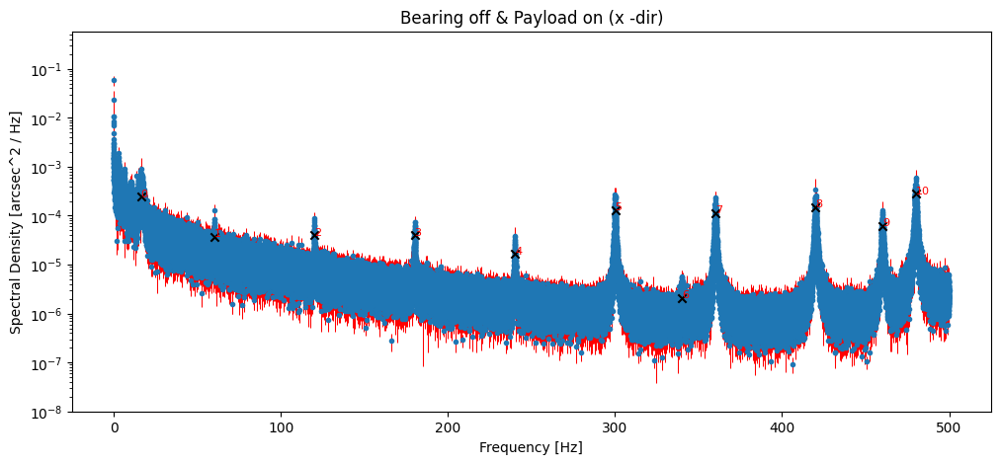

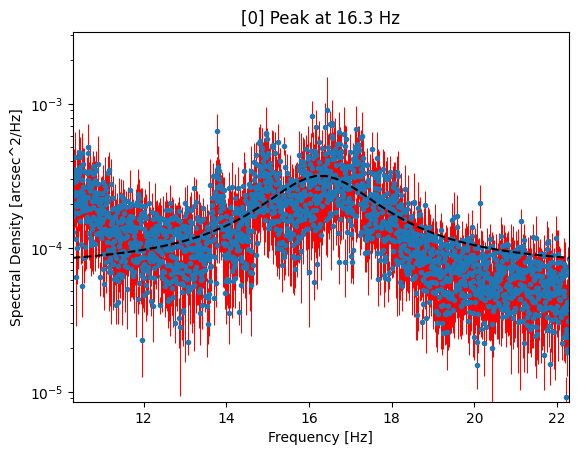

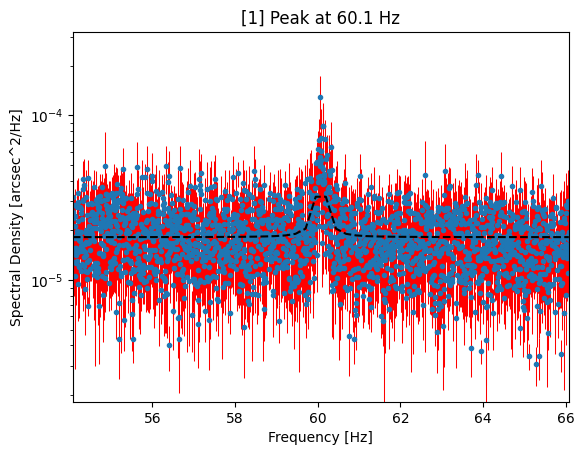

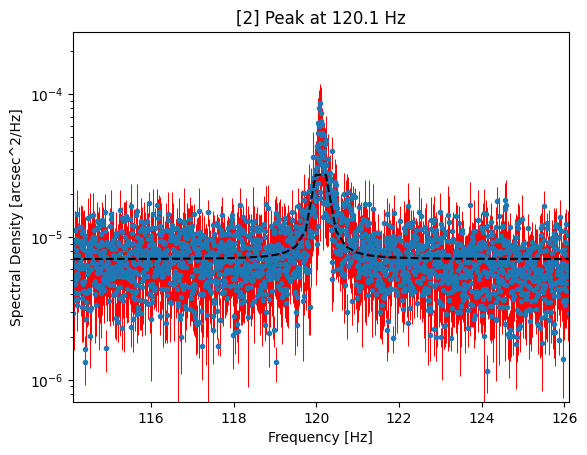

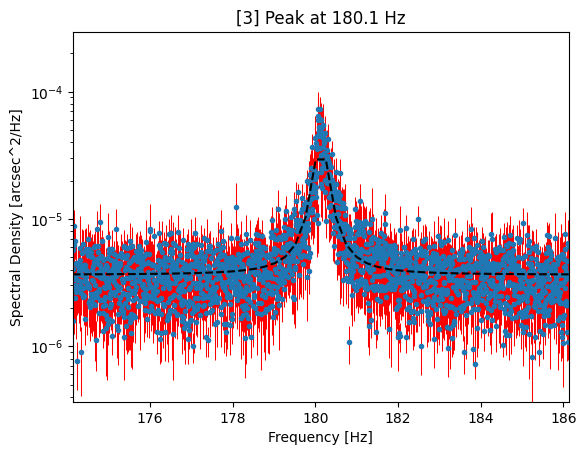

...

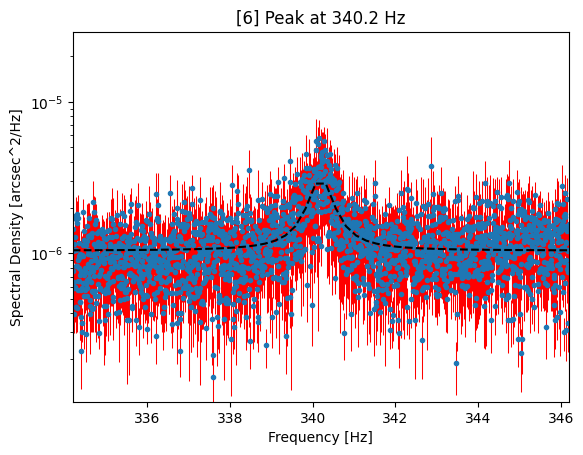

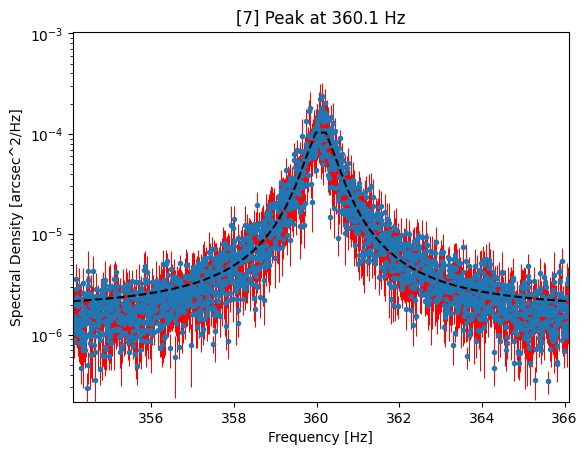

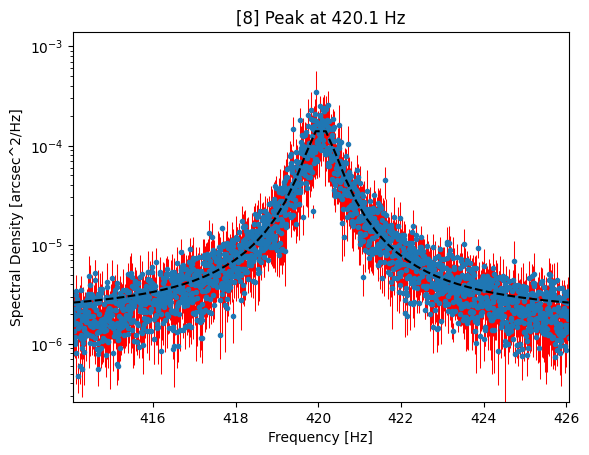

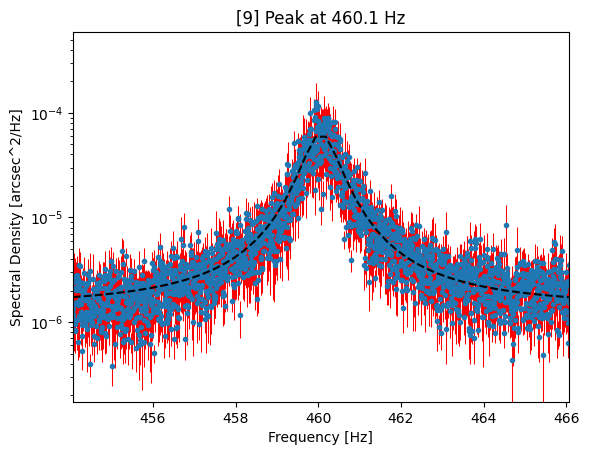

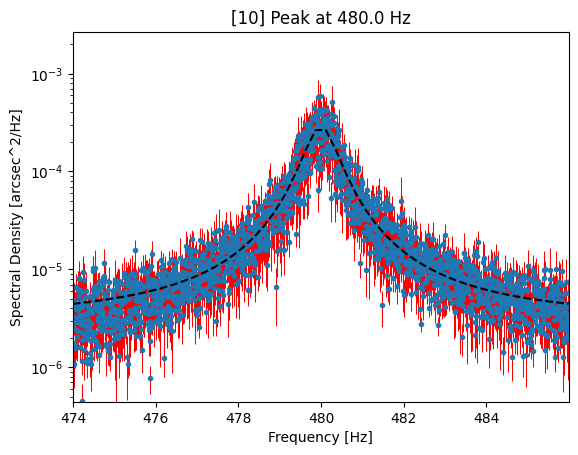

In [ ]:
plot_peaks(bearingoff_electronicson_test_xpeaks, bearingoff_electronicson_freqs, bearingoff_electronicson_xspec_avgs,bearingoff_electronicson_xspec_sem, 'Bearing off & Payload on (x -dir)', 'x')

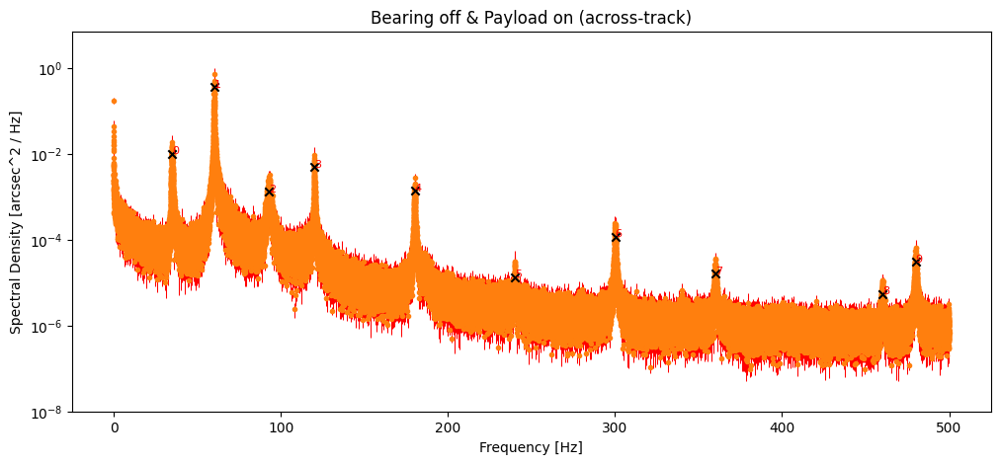

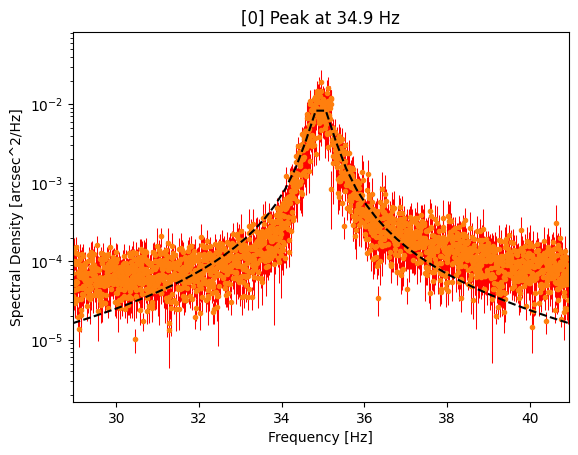

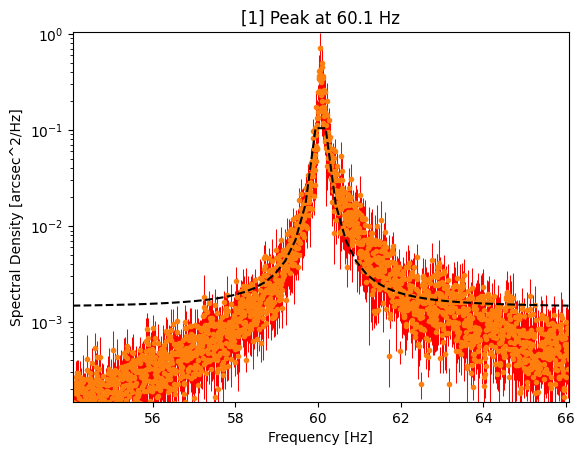

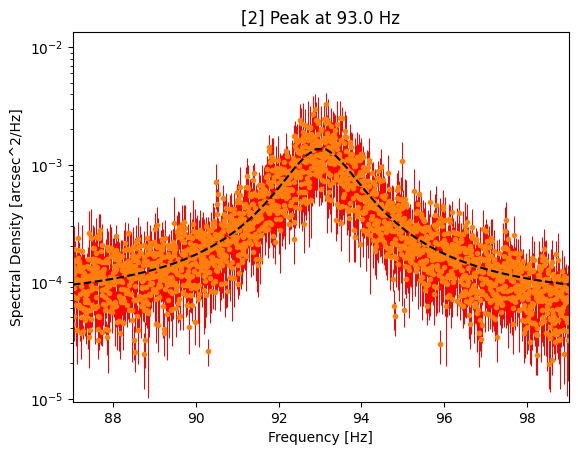

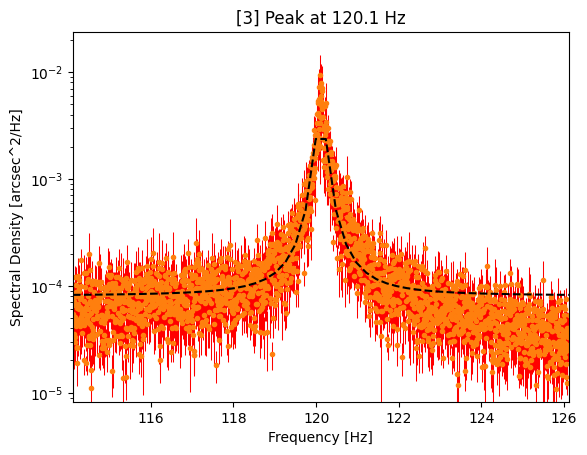

...

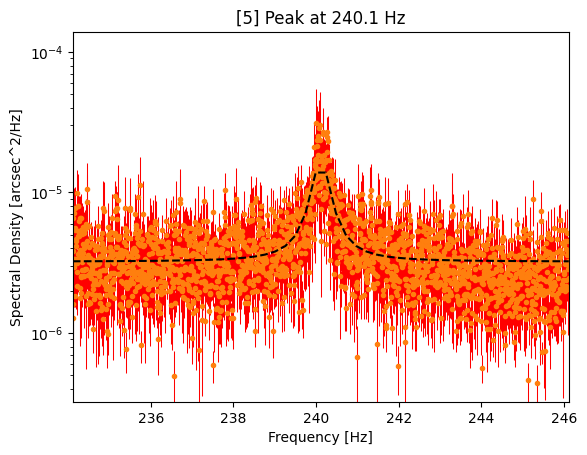

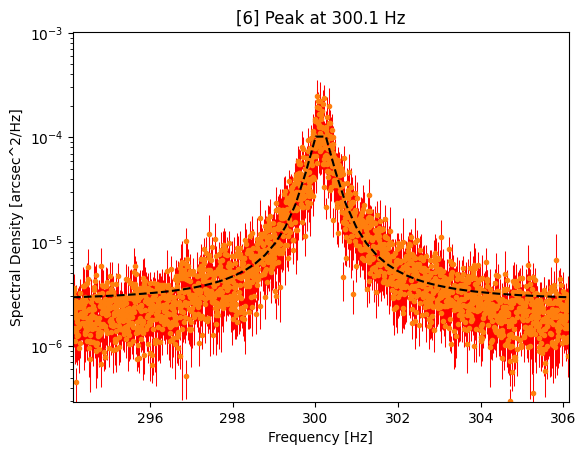

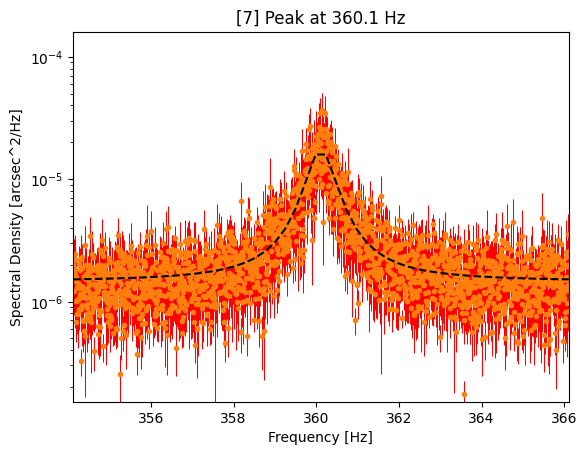

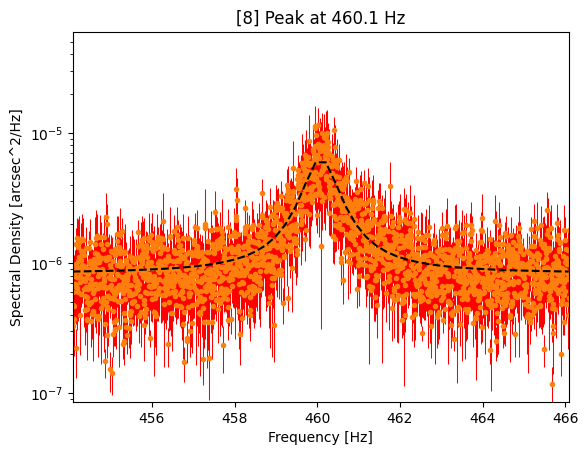

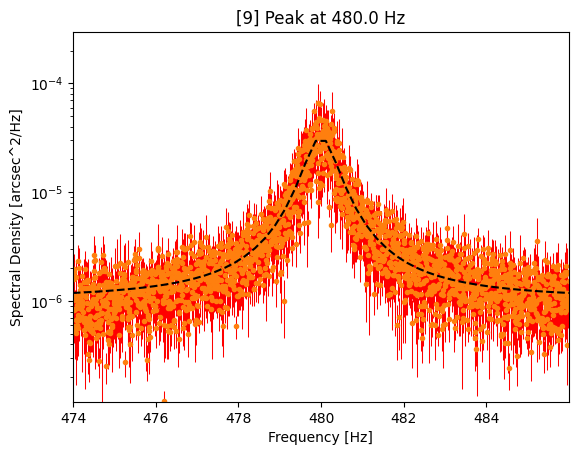

In [ ]:
plot_peaks(bearingoff_electronicson_test_ypeaks, bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs,bearingoff_electronicson_yspec_sem, 'Bearing off & Payload on (across-track)', 'y')

In [ ]:
bearingoff_electronicson_test_ypeaks

array([[ 3.49434593e+01,  1.01700754e-02,  2.57351616e-01,
        -2.35326799e-06,  1.03644715e-05,  1.61901096e-08,
         2.38395479e-05,  3.59047829e-10,  8.92738588e-02,
         1.41602598e-10],
       [ 6.00615723e+01,  3.65827552e-01,  7.67039233e-02,
         1.42751344e-03,  1.02397079e-06,  2.32946863e-05,
         2.13279696e-06,  1.26733021e-07,  3.23368406e-01,
         2.73434377e-10],
       [ 9.30207708e+01,  1.30968316e-03,  8.88468248e-01,
         6.61673470e-05,  1.61096310e-04,  3.57752571e-10,
         5.44253326e-04,  5.50097701e-11,  6.40896104e-02,
         3.23101308e-10],
       [ 1.20111701e+02,  4.94162527e-03,  1.13546202e-01,
         8.04470581e-05,  2.36623454e-06,  4.48099296e-09,
         5.02727146e-06,  3.75369833e-11,  5.20277482e-02,
         6.42503126e-11],
       [ 1.80130809e+02,  1.38677637e-03,  1.69277204e-01,
         1.92491792e-05,  3.85001154e-06,  2.58400187e-10,
         8.43203134e-06,  3.42579322e-12,  3.09068834e-02,
         4.

In [ ]:
manually_fit(bearingoff_electronicson_freqs, bearingoff_electronicson_yspec_avgs,bearingoff_electronicson_yspec_sem, 35, 0.2,0.2, 3, 1e-3, 'y')

#############################


In [ ]:
bearingoff_electronicson_x_spec_powers = pd.DataFrame([bearingoff_electronicson_6_xpsc[1],bearingoff_electronicson_7_xpsc[1], bearingoff_electronicson_8_xpsc[1],bearingoff_electronicson_9_xpsc[1],
                                                       bearingoff_electronicson_10_xpsc[1],bearingoff_electronicson_11_xpsc[1]])
bearingoff_electronicson_y_spec_powers = pd.DataFrame([bearingoff_electronicson_6_ypsc[1],bearingoff_electronicson_7_ypsc[1], bearingoff_electronicson_8_ypsc[1],bearingoff_electronicson_9_ypsc[1],
                                                       bearingoff_electronicson_10_ypsc[1],bearingoff_electronicson_11_ypsc[1]])

In [ ]:
bearingoff_electronicson_x_avgs = bearingoff_electronicson_x_spec_powers.mean(axis = 0)
bearingoff_electronicson_x_SEM = bearingoff_electronicson_x_spec_powers.sem(axis = 0)
bearingoff_electronicson_y_avgs = bearingoff_electronicson_y_spec_powers.mean(axis = 0)
bearingoff_electronicson_y_SEM = bearingoff_electronicson_y_spec_powers.sem(axis =  0)

In [ ]:
avged_x_bearingoff_electronicson_fig, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_x_avgs, yerr= bearingoff_electronicson_x_SEM, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75)
# ax.set_xlim(479,481)
# ax.set_ylim(0,5e-14)
ax.set_title('Averaged Bearingoff, Payload & Cryo on (x - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [V^2 / Hz]')

In [ ]:
avged_y_bearingoff_electronicson_fig, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, bearingoff_electronicson_y_avgs, yerr= bearingoff_electronicson_y_SEM, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75)
# ax.set_xlim(179,181)
# ax.set_ylim(0,2e-13)
ax.set_title('Averaged Bearing off, Payload & Cryo on (y - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [V^2 / Hz]')

# Subtract the platform average PSD ("background") from the PSD's that had the sources (bearing off, payload & cryo on).

We will call these - "reduced"

In [ ]:
#recall the psd's [arcsec^2 / Hz]
platform_xarcsec_avgs = platform_x_spec_powers_arcsec.mean(axis = 0)
platform_xarcsec_SEM = platform_x_spec_powers_arcsec.sem(axis = 0)
platform_yarcsec_avgs = platform_y_spec_powers_arcsec.mean(axis = 0)
platform_yarcsec_SEM = platform_y_spec_powers_arcsec.sem(axis =  0)

NameError: name 'platform_x_spec_powers_arcsec' is not defined

In [ ]:
bearingoff_electronicson_xspec_avgs = bearingoff_electronicson_xspec_powers.mean(axis = 0)
bearingoff_electronicson_xspec_sem = bearingoff_electronicson_xspec_powers.sem(axis = 0)
bearingoff_electronicson_yspec_avgs = bearingoff_electronicson_yspec_powers.mean(axis = 0)
bearingoff_electronicson_yspec_sem = bearingoff_electronicson_yspec_powers.sem(axis = 0)

In [ ]:
reduced_bearingoff_electronicson_x = bearingoff_electronicson_xspec_avgs - platform_xarcsec_avgs
reduced_bearingoff_electronicson_x_err = np.sqrt(bearingoff_electronicson_xspec_sem**2 + platform_xarcsec_SEM**2)

reduced_bearingoff_electronicsoff_fig_x, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, reduced_bearingoff_electronicson_x, yerr= reduced_bearingoff_electronicson_x_err, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75)
# ax.set_xlim(479, 481)
ax.set_ylim(-0.0005,0.0005)
ax.set_title('Reduced Bearing off, Payload & Cryo on (x - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

NameError: name 'platform_xarcsec_avgs' is not defined

In [ ]:
reduced_bearingoff_electronicson_x

NameError: name 'reduced_bearingoff_electronicson_x' is not defined

In [ ]:
reduced_bearingoff_electronicson_y = bearingoff_electronicson_yspec_avgs - platform_yarcsec_avgs
reduced_bearingoff_electronicson_y_err = np.sqrt(bearingoff_electronicson_yspec_sem**2 + platform_yarcsec_SEM **2) #error propagation

reduced_bearingoff_electronicsoff_fig_y, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, reduced_bearingoff_electronicson_y, yerr= reduced_bearingoff_electronicson_y_err, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75)
ax.set_xlim(179,181)
# ax.set_ylim(0,2e-13)
ax.set_title('Reduced Bearing off, Payload & Cryo on (y - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

NameError: name 'platform_yarcsec_avgs' is not defined

In [ ]:
#first check if the frequency binning is the same
bearingoff_electronicson_freqs, platform_x_freqs

In [ ]:
reduced_bearingoff_electronicson_y = bearingoff_electronicson_y_avgs - platform_y_avgs
reduced_bearingoff_electronicson_y_err = np.sqrt(bearingoff_electronicson_y_SEM**2 + platform_y_SEM**2) #error propagation

reduced_bearingoff_electronicsoff_fig_y, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, reduced_bearingoff_electronicson_y, yerr= reduced_bearingoff_electronicson_y_err, fmt = 'C1.', ecolor = 'red', elinewidth = 0.75)
ax.set_xlim(179,181)
ax.set_ylim(0,2e-13)
ax.set_title('Reduced Bearing off, Payload & Cryo on (y - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [V^2 / Hz]')

In [ ]:
reduced_bearingoff_electronicson_x = bearingoff_electronicson_x_avgs - platform_x_avgs
reduced_bearingoff_electronicson_x_err = np.sqrt(bearingoff_electronicson_x_SEM**2 + platform_x_SEM**2)

reduced_bearingoff_electronicsoff_fig_x, ax = plt.subplots(figsize = (15,5))
ax.errorbar(bearingoff_electronicson_freqs, reduced_bearingoff_electronicson_x, yerr= reduced_bearingoff_electronicson_x_err, fmt = 'C0.', ecolor = 'red', elinewidth = 0.75)
ax.set_xlim(479, 481)
ax.set_ylim(0,5e-14)
ax.set_title('Reduced Bearing off, Payload & Cryo on (x - direction)')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Spectral Density [arcsec^2 / Hz]')

The next sensible thing to do is to export all this data as data frames.

Save the average PSD to the csv.

In [ ]:
platform_x_avgs.to_csv('platform_x_avgs.csv')
platform_y_avgs.to_csv('platform_y_avgs.csv')
bearingoff_electronicson_x_avgs.to_csv('bearingoff_electronicson_x_avgs.csv')
bearingoff_electronicson_x_SEM.to_csv('bearingoff_electronicson_x_SEM.csv')
bearingoff_electronicson_y_avgs.to_csv('bearingoff_electronicson_y_avgs.csv')
bearingoff_electronicson_y_SEM.to_csv('bearingoff_electronicson_y_SEM.csv')

In [ ]:
platform_x_SEM.to_csv('platform_x_SEM.csv')
platform_y_SEM.to_csv('platform_y_SEM.csv')